## Author : Indumathi Pandiyan

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00008B;"> Featurization & Model Tuning(FMT) Project - 5th Project submitted for PGP-AIML Great Learning on 06-Feb-2022

**• DOMAIN:**Semiconductor manufacturing process <br>

**• CONTEXT:** A complex modern semiconductor manufacturing process is normally under constant surveillance via the monitoring of
signals/variables collected from sensors and or process measurement points. However, not all of these signals are equally valuable in a
specific monitoring system. The measured signals contain a combination of useful information, irrelevant information as well as noise.
Engineers typically have a much larger number of signals than are actually required. If we consider each type of signal as a feature, then
feature selection may be applied to identify the most relevant signals. The Process Engineers may then use these signals to determine key
factors contributing to yield excursions downstream in the process. This will enable an increase in process throughput, decreased time to
learning and reduce the per unit production costs. These signals can be used as features to predict the yield type. And by analysing and
trying out different combinations of features, essential signals that are impacting the yield type can be identified. <br>

**• DATA Description:** <br>
sensor-data.csv : (1567, 592)
The data consists of 1567 datapoints each with 591 features.
The dataset presented in this case represents a selection of such features where each example represents a single production entity with
associated measured features and the labels represent a simple pass/fail yield for in house line testing. Target column “ –1” corresponds to
a pass and “1” corresponds to a fail and the data time stamp is for that specific test point

**PROJECT OBJECTIVE:**<br> We will build a classifier to predict the Pass/Fail yield of a particular process entity and analyse whether all the features are required to build the model or not.


## Steps and tasks: [ Total Score: 60 points]
<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">1.Import and understand the data. [5 Marks]

In [4]:
### Importing Required Libraries
import pandas as pd
from sklearn.cluster import KMeans 
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats; from scipy.stats import zscore, norm, randint

In [5]:
# Ignore warnings
import warnings
warnings.filterwarnings("ignore")
#

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">A.Import ‘signal-data.csv’ as DataFrame. [2 Marks]

In [6]:
signal_data = pd.read_csv("signal-data.csv")  # import the csv file
signal_data.head()

,Time,0,1,2,3,4,5,6,7,8,...,581,582,583,584,585,586,587,588,589,Pass/Fail
0,2008-07-19 11:55:00,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,1.5005,...,NaN,0.5005,0.0118,0.0035,2.3630,NaN,NaN,NaN,NaN,-1
1,2008-07-19 12:32:00,3095.78,2465.14,2230.4222,1463.6606,0.8294,100.0,102.3433,0.1247,1.4966,...,208.2045,0.5019,0.0223,0.0055,4.4447,0.0096,0.0201,0.0060,208.2045,-1
2,2008-07-19 13:17:00,2932.61,2559.94,2186.4111,1698.0172,1.5102,100.0,95.4878,0.1241,1.4436,...,82.8602,0.4958,0.0157,0.0039,3.1745,0.0584,0.0484,0.0148,82.8602,1
3,2008-07-19 14:43:00,2988.72,2479.90,2199.0333,909.7926,1.3204,100.0,104.2367,0.1217,1.4882,...,73.8432,0.4990,0.0103,0.0025,2.0544,0.0202,0.0149,0.0044,73.8432,-1
4,2008-07-19 15:22:00,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.0,100.3967,0.1235,1.5031,...,NaN,0.4800,0.4766,0.1045,99.3032,0.0202,0.0149,0.0044,73.8432,-1


In [7]:
signal_data.shape

(1567, 592)

#### Observation:<br>
There are are 1567 samples and 592 features /attributes in Signal data

In [8]:
signal_data.dtypes.value_counts()

float64    590
object       1
int64        1
dtype: int64

#### Observation:<br>
In the features 590 are float and one integer type and one is object type

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">B.Print 5 point summary and share at least 2 observations. [3 Marks]

In [9]:
signal_data.describe().T

,count,mean,std,min,25%,50%,75%,max
0,1561.0,3014.452896,73.621787,2743.2400,2966.260000,3011.4900,3056.6500,3356.3500
1,1560.0,2495.850231,80.407705,2158.7500,2452.247500,2499.4050,2538.8225,2846.4400
2,1553.0,2200.547318,29.513152,2060.6600,2181.044400,2201.0667,2218.0555,2315.2667
3,1553.0,1396.376627,441.691640,0.0000,1081.875800,1285.2144,1591.2235,3715.0417
4,1553.0,4.197013,56.355540,0.6815,1.017700,1.3168,1.5257,1114.5366
...,...,...,...,...,...,...,...,...
586,1566.0,0.021458,0.012358,-0.0169,0.013425,0.0205,0.0276,0.1028
587,1566.0,0.016475,0.008808,0.0032,0.010600,0.0148,0.0203,0.0799
588,1566.0,0.005283,0.002867,0.0010,0.003300,0.0046,0.0064,0.0286
589,1566.0,99.670066,93.891919,0.0000,44.368600,71.9005,114.7497,737.3048


### Observations<br>
1. From the above five point summary its observed that few features having varying counts ranges from 1553 to 1566. It shows presence of empty or null values<br>
2. Pass adn Fail shows minimum as -1.0 and maximum as 1, it shows fail is represented as -1 and pass as 1.<br>
3. For the shown features 0 to 3 and 587, 588 mean is almost equal to median which shows these features are normally distributed<br>
4. the feature number 4 has all values has very less value where as maximum is 1114.53 it clearly indicates the outlier presence<br>


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">2. Data cleansing: [15 Marks]

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">A. Write a for loop which will remove all the features with 20%+ Null values and impute rest with mean of the feature. [5 Marks]


In [10]:
signal_data.shape

(1567, 592)

In [11]:
##copying data for doing the imputation
sdata=signal_data.copy()

In [12]:
sdata.shape

(1567, 592)

## Method to remove the null columns which have more than 20%

In [13]:
def remove_null_columns(data,percentageLimit):
    percent_missing = round(data.isnull().sum() * 100 / len(data),2) #percentage of missing value
    missing_value_data = pd.DataFrame({'Feature Name': data.columns,
                                 'percent_missing': percent_missing})
    featurelist_more_null=missing_value_data.get(percent_missing>percentageLimit)
    cols_to_drop=featurelist_more_null['Feature Name']
    print(len(cols_to_drop))
    data.drop(labels=cols_to_drop, axis=1,inplace=True)
    return data

In [14]:
sdata=remove_null_columns(sdata,20)

32


In [15]:
sdata.shape

(1567, 560)

**Comments** : 32 features which has more than 20% null value are removed

## Imputing with Mean for other null values

In [16]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='mean')
imputer = imputer.fit(sdata.iloc[:,1:-1])
## Replacing the Null value from the column 0 to last but one column
sdata.iloc[:,1:-1] = imputer.transform(sdata.iloc[:,1:-1])
sdata.head()

,Time,0,1,2,3,4,5,6,7,8,...,577,582,583,584,585,586,587,588,589,Pass/Fail
0,2008-07-19 11:55:00,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,1.5005,...,14.9509,0.5005,0.0118,0.0035,2.3630,0.021458,0.016475,0.005283,99.670066,-1
1,2008-07-19 12:32:00,3095.78,2465.14,2230.4222,1463.6606,0.8294,100.0,102.3433,0.1247,1.4966,...,10.9003,0.5019,0.0223,0.0055,4.4447,0.009600,0.020100,0.006000,208.204500,-1
2,2008-07-19 13:17:00,2932.61,2559.94,2186.4111,1698.0172,1.5102,100.0,95.4878,0.1241,1.4436,...,9.2721,0.4958,0.0157,0.0039,3.1745,0.058400,0.048400,0.014800,82.860200,1
3,2008-07-19 14:43:00,2988.72,2479.90,2199.0333,909.7926,1.3204,100.0,104.2367,0.1217,1.4882,...,8.5831,0.4990,0.0103,0.0025,2.0544,0.020200,0.014900,0.004400,73.843200,-1
4,2008-07-19 15:22:00,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.0,100.3967,0.1235,1.5031,...,10.9698,0.4800,0.4766,0.1045,99.3032,0.020200,0.014900,0.004400,73.843200,-1


In [17]:
sdata.isnull().sum().sum()

0

### Comments:<br>
* All null value in the dataset are handled.<br>
* The features with more than 20% are dropped and other values imputed are imputed by mean.

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">B.Identify and drop the features which are having same value for all the rows. [3 Marks]

In [18]:
cols= sdata.columns

In [19]:
cols

Index(['Time', '0', '1', '2', '3', '4', '5', '6', '7', '8',
       ...
       '577', '582', '583', '584', '585', '586', '587', '588', '589',
       'Pass/Fail'],
      dtype='object', length=560)

### Code to identify same value columns

In [20]:
samevalue_columns=[]
for col in cols:
    if(sdata[col].nunique()==1):##if value count for a column is 1 it signifies same values
       samevalue_columns.append(col)##
       #print(col)
print('number of columns',len(samevalue_columns))

number of columns 116


In [21]:
print(samevalue_columns)

['5', '13', '42', '49', '52', '69', '97', '141', '149', '178', '179', '186', '189', '190', '191', '192', '193', '194', '226', '229', '230', '231', '232', '233', '234', '235', '236', '237', '240', '241', '242', '243', '256', '257', '258', '259', '260', '261', '262', '263', '264', '265', '266', '276', '284', '313', '314', '315', '322', '325', '326', '327', '328', '329', '330', '364', '369', '370', '371', '372', '373', '374', '375', '378', '379', '380', '381', '394', '395', '396', '397', '398', '399', '400', '401', '402', '403', '404', '414', '422', '449', '450', '451', '458', '461', '462', '463', '464', '465', '466', '481', '498', '501', '502', '503', '504', '505', '506', '507', '508', '509', '512', '513', '514', '515', '528', '529', '530', '531', '532', '533', '534', '535', '536', '537', '538']


In [22]:
sdata.drop(labels=samevalue_columns, axis=1,inplace=True)

In [23]:
sdata.shape

(1567, 444)

In [24]:
#sdata.to_csv('sdata_cleared_features.csv')

In [25]:
sdata.describe().T

,count,mean,std,min,25%,50%,75%,max
0,1567.0,3014.452896,73.480613,2743.2400,2966.66500,3011.8400,3056.5400,3356.3500
1,1567.0,2495.850231,80.227793,2158.7500,2452.88500,2498.9100,2538.7450,2846.4400
2,1567.0,2200.547318,29.380932,2060.6600,2181.09995,2200.9556,2218.0555,2315.2667
3,1567.0,1396.376627,439.712852,0.0000,1083.88580,1287.3538,1590.1699,3715.0417
4,1567.0,4.197013,56.103066,0.6815,1.01770,1.3171,1.5296,1114.5366
...,...,...,...,...,...,...,...,...
586,1567.0,0.021458,0.012354,-0.0169,0.01345,0.0205,0.0276,0.1028
587,1567.0,0.016475,0.008805,0.0032,0.01060,0.0148,0.0203,0.0799
588,1567.0,0.005283,0.002866,0.0010,0.00330,0.0046,0.0064,0.0286
589,1567.0,99.670066,93.861936,0.0000,44.36860,72.0230,114.7497,737.3048


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">C.Drop other features if required using relevant functional knowledge. Clearly justify the same. [2 Marks]

In [26]:
zerocolumns=[]
for col in sdata.columns:
    count = (sdata[col] == 0).sum()
    if(count>1500):
        print('column',col,'number of rows that has zero',count)
        zerocolumns.append(col)

column 74 number of rows that has zero 1560
column 114 number of rows that has zero 1545
column 206 number of rows that has zero 1560
column 209 number of rows that has zero 1560
column 249 number of rows that has zero 1545
column 342 number of rows that has zero 1560
column 347 number of rows that has zero 1560
column 387 number of rows that has zero 1545
column 478 number of rows that has zero 1560
column 521 number of rows that has zero 1546


In [27]:
print('initial columns',len(zerocolumns))
i=0
categorical_column=[]
for col in zerocolumns:
    if(sdata[col].nunique()==2):
        i=i+1
        categorical_column.append(col)
        print(col)

print('categorical columns for validation',len(categorical_column))

initial columns 10
categorical columns for validation 0


### Comments:<br>
* Among the data no value is categorical and more values having zero and more than 1500 records having zero.
And those not categorical too, These will not help in the model building. Hence decided to drop them.
* 10 columns can be removed by this assumption


In [28]:
sdata.drop(labels=zerocolumns, axis=1,inplace=True)

In [29]:
sdata.shape

(1567, 434)

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">D.Check for multi-collinearity in the data and take necessary action. [3 Marks]

### Comments<br>
By analysis its found that more features had multicollinearilty hence decided to check correlation value and remove them
and applying the VIF to remove high multicollinear columns <br>
1. Find correlation and remove columns having more correlation than **0.7** <br>
2. Find multicollinear columns having more than threshold of **10** <br>

In [30]:
correlated_features = set()
correlation_matrix  =sdata.corr()
print(correlation_matrix )

                  0         1         2         3         4         6  \
0          1.000000 -0.143840  0.004756 -0.007613 -0.011014  0.002270   
1         -0.143840  1.000000  0.005767 -0.007568 -0.001636 -0.025564   
2          0.004756  0.005767  1.000000  0.298935  0.095891 -0.136225   
3         -0.007613 -0.007568  0.298935  1.000000 -0.058483 -0.685835   
4         -0.011014 -0.001636  0.095891 -0.058483  1.000000 -0.074368   
...             ...       ...       ...       ...       ...       ...   
586        0.018443 -0.009403 -0.025495  0.034711 -0.043929 -0.041209   
587       -0.025880  0.017266 -0.029345 -0.039132 -0.031005  0.034027   
588       -0.028166  0.010118 -0.030818 -0.033645 -0.026100  0.032227   
589        0.004174  0.044797 -0.032890 -0.080341  0.050910  0.043777   
Pass/Fail -0.025141 -0.002603 -0.000957 -0.024623 -0.013756  0.016239   

                  7         8         9        10  ...       577       582  \
0          0.031483 -0.052622  0.009045  0.00

In [31]:
##method to find the correlated columns
for i in range(len(correlation_matrix .columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.7:
            colname = correlation_matrix.columns[i]
            correlated_features.add(colname)

In [32]:
len(correlated_features)

233

### Comments: 233 columns has more correation than 0.7

In [33]:
sdata.shape

(1567, 434)

In [34]:
print(correlated_features)

{'287', '567', '36', '431', '452', '341', '361', '360', '298', '350', '470', '205', '339', '524', '541', '336', '296', '354', '527', '199', '312', '123', '551', '174', '279', '351', '335', '349', '425', '46', '413', '391', '125', '576', '333', '334', '271', '545', '320', '440', '127', '362', '490', '540', '165', '66', '140', '416', '471', '494', '254', '96', '337', '283', '405', '447', '430', '27', '427', '367', '454', '288', '302', '355', '130', '437', '523', '332', '187', '22', '252', '568', '294', '60', '386', '477', '496', '522', '584', '148', '453', '426', '343', '164', '198', '429', '467', '569', '539', '299', '457', '409', '204', '50', '278', '285', '474', '557', '406', '357', '554', '469', '368', '428', '552', '304', '338', '290', '388', '497', '553', '560', '154', '280', '417', '441', '197', '390', '392', '407', '421', '525', '319', '439', '445', '308', '324', '303', '556', '555', '104', '412', '272', '435', '456', '434', '207', '70', '203', '340', '424', '26', '493', '573', '

In [35]:
sdata.drop(labels=correlated_features, axis=1, inplace=True)

In [36]:
sdata.shape

(1567, 201)

In [37]:
sdata.dtypes.value_counts()

float64    199
object       1
int64        1
dtype: int64

In [38]:
#### Data preparation for applying VIF

In [39]:
import pandas as pd
import numpy as np
from statsmodels.stats.outliers_influence import variance_inflation_factor
labels=['Pass/Fail','Time']
X = sdata.drop(labels= labels , axis = 1)
y = sdata["Pass/Fail"]
print('x shape',X.shape[1])
#vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
#print(vif)

x shape 199


In [40]:
labels=['Pass/Fail','Time']
#newdata = sdata.drop(labels= labels , axis = 1)
newdata = X.copy()

In [41]:
X.shape

(1567, 199)

In [42]:
columnsToDrop=[]

#### Method to verify the VIF Threshold and return the features that have high VIF than the specified threshold

In [43]:
def getVIF(data,VIFThreshold):
    vif = pd.DataFrame()
    vif["VIF Factor"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]
    vif["features"] = data.columns
    temp_df = vif.sort_values(by = 'VIF Factor',ascending = False)
    df_mask=vif['VIF Factor']>=VIFThreshold
    filered_df= vif[df_mask]
    print('shape of columns that have more than given Threshold',filered_df.shape)
    remove_columns=filered_df['features']
    return remove_columns

In [44]:
remove_columns=getVIF(X,10)

shape of columns that have more than given Threshold (118, 2)


In [45]:
columnsToDrop.append(remove_columns)

In [46]:
len(columnsToDrop[0])

118

In [47]:
sdata.head()

,Time,0,1,2,3,4,6,7,8,9,...,565,570,571,572,582,583,586,587,589,Pass/Fail
0,2008-07-19 11:55:00,3030.93,2564.00,2187.7333,1411.1265,1.3602,97.6133,0.1242,1.5005,0.0162,...,0.14561,533.8500,2.1113,8.95,0.5005,0.0118,0.021458,0.016475,99.670066,-1
1,2008-07-19 12:32:00,3095.78,2465.14,2230.4222,1463.6606,0.8294,102.3433,0.1247,1.4966,-0.0005,...,0.14561,535.0164,2.4335,5.92,0.5019,0.0223,0.009600,0.020100,208.204500,-1
2,2008-07-19 13:17:00,2932.61,2559.94,2186.4111,1698.0172,1.5102,95.4878,0.1241,1.4436,0.0041,...,0.62190,535.0245,2.0293,11.21,0.4958,0.0157,0.058400,0.048400,82.860200,1
3,2008-07-19 14:43:00,2988.72,2479.90,2199.0333,909.7926,1.3204,104.2367,0.1217,1.4882,-0.0124,...,0.16300,530.5682,2.0253,9.33,0.4990,0.0103,0.020200,0.014900,73.843200,-1
4,2008-07-19 15:22:00,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.3967,0.1235,1.5031,-0.0031,...,0.14561,532.0155,2.0275,8.83,0.4800,0.4766,0.020200,0.014900,73.843200,-1


In [48]:
len(remove_columns)

118

#### Removing the multicollinear columns from the dataset

In [49]:
sdata.drop(labels= remove_columns , axis = 1, inplace=True)

In [50]:
sdata.shape

(1567, 83)

Text(0.5, 1.0, 'Heat map of Semiconducter data after removing high collinear columns')

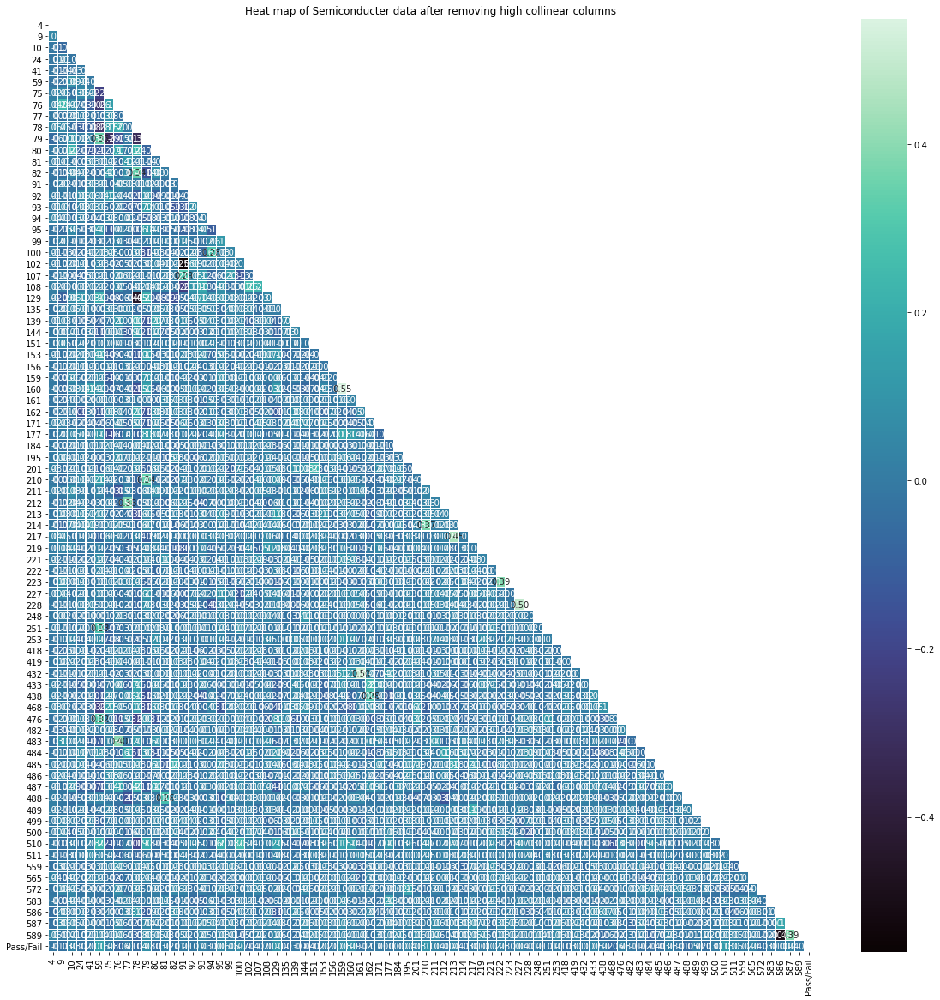

In [48]:
fig, ax = plt.subplots(figsize=(20,20))
#sns.heatmap(df2.corr(), center=0, cmap='BrBG', annot=True)
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(sdata.corr(), dtype=bool))
sns.heatmap(sdata.corr(), center=0, cmap='mako', annot=True, fmt='.2f', linewidths=0.05, mask=mask)
ax.set_title('Heat map of Semiconducter data after removing high collinear columns')

In [51]:
correlated_features = set()
correlation_matrix  =sdata.corr()
print(correlation_matrix )

                  4         9        10        24        41        59  \
4          1.000000  0.054206 -0.006470 -0.013636 -0.012742 -0.020577   
9          0.054206  1.000000 -0.064065  0.014420 -0.042435 -0.026476   
10        -0.006470 -0.064065  1.000000 -0.014916 -0.025927  0.085646   
24        -0.013636  0.014420 -0.014916  1.000000 -0.005596  0.036681   
41        -0.012742 -0.042435 -0.025927 -0.005596  1.000000 -0.007074   
...             ...       ...       ...       ...       ...       ...   
583       -0.001300 -0.036036  0.039060 -0.010550 -0.000840 -0.027673   
586       -0.043929  0.033738  0.000327  0.016466 -0.025716 -0.042800   
587       -0.031005  0.059301  0.046965  0.003232 -0.002800 -0.014624   
589        0.050910  0.004880  0.008393 -0.016735  0.013800  0.042628   
Pass/Fail -0.013756 -0.031191  0.033639 -0.018297  0.002480  0.155771   

                 75        76        77        78  ...       510       511  \
4          0.023082  0.042888 -0.000736  0.05

In [52]:
for i in range(len(correlation_matrix .columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.6:
            colname = correlation_matrix.columns[i]
            correlated_features.add(colname)

In [53]:
len(correlated_features)

0

In [54]:
sdata.shape

(1567, 83)

In [55]:
sdata.head(5)

,Time,4,9,10,24,41,59,75,76,77,...,510,511,559,565,572,583,586,587,589,Pass/Fail
0,2008-07-19 11:55:00,1.3602,0.0162,-0.0034,751.00,4.515,-1.7264,0.0126,-0.0206,0.0141,...,64.6707,0.0000,0.4385,0.14561,8.95,0.0118,0.021458,0.016475,99.670066,-1
1,2008-07-19 12:32:00,0.8294,-0.0005,-0.0148,-1640.25,2.773,0.8073,-0.0039,-0.0198,0.0004,...,141.4365,0.0000,0.1745,0.14561,5.92,0.0223,0.009600,0.020100,208.204500,-1
2,2008-07-19 13:17:00,1.5102,0.0041,0.0013,-1916.50,5.434,23.8245,-0.0078,-0.0326,-0.0052,...,240.7767,244.2748,0.3718,0.62190,11.21,0.0157,0.058400,0.048400,82.860200,1
3,2008-07-19 14:43:00,1.3204,-0.0124,-0.0033,-1657.25,1.279,24.3791,-0.0555,-0.0461,-0.0400,...,113.5593,0.0000,0.7288,0.16300,9.33,0.0103,0.020200,0.014900,73.843200,-1
4,2008-07-19 15:22:00,1.5334,-0.0031,-0.0072,117.00,2.209,-12.2945,-0.0534,0.0183,-0.0167,...,148.0663,0.0000,0.2156,0.14561,8.83,0.4766,0.020200,0.014900,73.843200,-1


**Comments**

* After doing clearing the multicollinear data with corr() and VIF, there is no data found with high correlation of more than threshold of 0.6
* Now the dataset has only less collinear data which is helpful for model building

In [56]:
signal_df=sdata.copy()

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">E.Make all relevant modifications on the data using both functional/logical reasoning/assumptions. [2 Marks]


In [407]:
signal_df.shape

(1567, 82)

#### Observation: <br>

* The timestamp,seems to have not much impact on the signals. <br>
* And might not be the factor for signal to pass or fail <br>

Hence dropping this column

In [409]:
signal_df.drop(labels='Time',axis=1,inplace=True)

In [410]:
signal_df.shape

(1567, 82)

In [60]:
## Method to find the Low Variance columns

In [411]:
import numpy as np
import pandas as pd
from sklearn.feature_selection import VarianceThreshold

# Just make a convenience function; this one wraps the VarianceThreshold
# transformer but you can pass it a pandas dataframe and get one in return

def get_low_variance_columns(dframe=None, columns=None,
                             skip_columns=None, thresh=0.0,
                             autoremove=False):
    """
    Wrapper for sklearn VarianceThreshold for use on pandas dataframes.
    """
    print("Finding low-variance features.")
    try:
        # get list of all the original df columns
        all_columns = dframe.columns
        print(len(all_columns))

        # remove `skip_columns`
        remaining_columns = all_columns.drop(skip_columns)

        # get length of new index
        max_index = len(remaining_columns) - 1

        # get indices for `skip_columns`
        skipped_idx = [all_columns.get_loc(column)
                       for column
                       in skip_columns]

        # adjust insert location by the number of columns removed
        # (for non-zero insertion locations) to keep relative
        # locations intact
        for idx, item in enumerate(skipped_idx):
            if item > max_index:
                diff = item - max_index
                skipped_idx[idx] -= diff
            if item == max_index:
                diff = item - len(skip_columns)
                skipped_idx[idx] -= diff
            if idx == 0:
                skipped_idx[idx] = item

        # get values of `skip_columns`
        skipped_values = dframe.iloc[:, skipped_idx].values

        # get dataframe values
        X = dframe.loc[:, remaining_columns].values

        # instantiate VarianceThreshold object
        vt = VarianceThreshold(threshold=thresh)

        # fit vt to data
        vt.fit(X)

        # get the indices of the features that are being kept
        feature_indices = vt.get_support(indices=True)

        # remove low-variance columns from index
        feature_names = [remaining_columns[idx]
                         for idx, _
                         in enumerate(remaining_columns)
                         if idx
                         in feature_indices]

        # get the columns to be removed
        removed_features = list(np.setdiff1d(remaining_columns,
                                             feature_names))
        print("Found {0} low-variance columns."
              .format(len(removed_features)))

        # remove the columns
        if autoremove & len(removed_features)>1:
            print("Removing low-variance features.")
            # remove the low-variance columns
            X_removed = vt.transform(X)

            print("Reassembling the dataframe (with low-variance "
                  "features removed).")
            # re-assemble the dataframe
            dframe = pd.DataFrame(data=X_removed,
                                  columns=feature_names)

            # add back the `skip_columns`
            for idx, index in enumerate(skipped_idx):
                dframe.insert(loc=index,
                              column=skip_columns[idx],
                              value=skipped_values[:, idx])
            print("Succesfully removed low-variance columns.")

        # do not remove columns
        else:
            print("No changes have been made to the dataframe.")

    except Exception as e:
        print(e)
        print("Could not remove low-variance features. Something "
              "went wrong.")
        pass

    return dframe, removed_features

In [412]:
signal_df.columns

Index(['4', '9', '10', '24', '41', '59', '75', '76', '77', '78', '79', '80',
       '81', '82', '91', '92', '93', '94', '95', '99', '100', '102', '107',
       '108', '129', '135', '139', '144', '151', '153', '156', '159', '160',
       '161', '162', '171', '177', '184', '195', '201', '210', '211', '212',
       '213', '214', '217', '219', '221', '222', '223', '227', '228', '248',
       '251', '253', '418', '419', '432', '433', '438', '468', '476', '482',
       '483', '484', '485', '486', '487', '488', '489', '499', '500', '510',
       '511', '559', '565', '572', '583', '586', '587', '589', 'Pass/Fail'],
      dtype='object')

In [413]:
skip_columns=['Pass/Fail']

In [64]:
dframe, removed_features=get_low_variance_columns(signal_df,signal_df.columns,skip_columns,0.0,True)

Finding low-variance features.
82
Found 0 low-variance columns.
No changes have been made to the dataframe.


In [65]:
len(removed_features)

0

### Comments :<br>
* There is no features found with Low variance

In [66]:
so_numeric_df =signal_df.select_dtypes(include=[int,float])
features=so_numeric_df.columns
print(features)
print(len(features))

Index(['4', '9', '10', '24', '41', '59', '75', '76', '77', '78', '79', '80',
       '81', '82', '91', '92', '93', '94', '95', '99', '100', '102', '107',
       '108', '129', '135', '139', '144', '151', '153', '156', '159', '160',
       '161', '162', '171', '177', '184', '195', '201', '210', '211', '212',
       '213', '214', '217', '219', '221', '222', '223', '227', '228', '248',
       '251', '253', '418', '419', '432', '433', '438', '468', '476', '482',
       '483', '484', '485', '486', '487', '488', '489', '499', '500', '510',
       '511', '559', '565', '572', '583', '586', '587', '589'],
      dtype='object')
81


In [67]:
signal_df.head()

,4,9,10,24,41,59,75,76,77,78,...,510,511,559,565,572,583,586,587,589,Pass/Fail
0,1.3602,0.0162,-0.0034,751.00,4.515,-1.7264,0.0126,-0.0206,0.0141,-0.0307,...,64.6707,0.0000,0.4385,0.14561,8.95,0.0118,0.021458,0.016475,99.670066,-1
1,0.8294,-0.0005,-0.0148,-1640.25,2.773,0.8073,-0.0039,-0.0198,0.0004,-0.0440,...,141.4365,0.0000,0.1745,0.14561,5.92,0.0223,0.009600,0.020100,208.204500,-1
2,1.5102,0.0041,0.0013,-1916.50,5.434,23.8245,-0.0078,-0.0326,-0.0052,0.0213,...,240.7767,244.2748,0.3718,0.62190,11.21,0.0157,0.058400,0.048400,82.860200,1
3,1.3204,-0.0124,-0.0033,-1657.25,1.279,24.3791,-0.0555,-0.0461,-0.0400,0.0400,...,113.5593,0.0000,0.7288,0.16300,9.33,0.0103,0.020200,0.014900,73.843200,-1
4,1.5334,-0.0031,-0.0072,117.00,2.209,-12.2945,-0.0534,0.0183,-0.0167,-0.0449,...,148.0663,0.0000,0.2156,0.14561,8.83,0.4766,0.020200,0.014900,73.843200,-1


#### comments: Replacing -1 to 0 for easy understanding of failure scenarios

In [414]:
signal_df['Pass/Fail'].replace({-1:0},inplace=True)


In [415]:
signal_df.head()

,4,9,10,24,41,59,75,76,77,78,...,510,511,559,565,572,583,586,587,589,Pass/Fail
0,1.3602,0.0162,-0.0034,751.00,4.515,-1.726400,0.0126,-0.0206,0.0141,-0.0307,...,64.670700,0.0000,0.4385,0.145610,8.95,0.01180,0.021458,0.016475,99.670066,0
1,0.8294,-0.0005,-0.0148,-1640.25,2.773,0.807300,-0.0039,-0.0198,0.0004,-0.0440,...,107.584525,0.0000,0.1745,0.145610,5.92,0.02230,0.009600,0.020100,208.204500,0
2,1.5102,0.0041,0.0013,-1916.50,4.739,13.627425,-0.0078,-0.0326,-0.0052,0.0213,...,107.584525,244.2748,0.3718,0.285575,11.21,0.01570,0.048825,0.034850,82.860200,1
3,1.3204,-0.0124,-0.0033,-1657.25,1.475,13.627425,-0.0555,-0.0461,-0.0400,0.0400,...,107.584525,0.0000,0.7288,0.163000,9.33,0.01030,0.020200,0.014900,73.843200,0
4,1.5334,-0.0031,-0.0072,117.00,2.209,-11.145175,-0.0534,0.0183,-0.0167,-0.0449,...,107.584525,0.0000,0.2156,0.145610,8.83,0.02385,0.020200,0.014900,73.843200,0


In [70]:
signal_df_copy=signal_df.copy()

## Handling the Outlier

In [71]:
signal_df_before=signal_df.copy()
signal_df_im=signal_df.copy()

#### Method to handle Outlier by Capping method

In [72]:
def IQR_capping(data,cols,factor):
    for col in cols:
        #print('before outlier')
        #sns.boxplot(data[col],data=data)
        q1=data[col].quantile(0.25)
        q3=data[col].quantile(0.75)
        
        IQR=q3-q1
        #print('IQR',IQR)
        upper_whisker= q3+(factor*IQR)
        lower_whisker =q1-(factor*IQR)
        #print('upper_whisker is',upper_whisker,'lower_whisker is',lower_whisker)
        #if column value greater than upper whisker cap it with upper whisker
        #else if value less than lower whisker cap with it lower whisker
        # if value is not greater than upper whisker and not lower than lower whishker retain the value
        data[col]=np.where(data[col]>upper_whisker,upper_whisker,np.where(data[col]<lower_whisker,lower_whisker,data[col]))
        #print("After Outlier")
    #sns.boxplot(data[col],data=data)
    return data

In [73]:
signal_df_im=IQR_capping(signal_df,features,1.5)

### Box plot before outlier handling

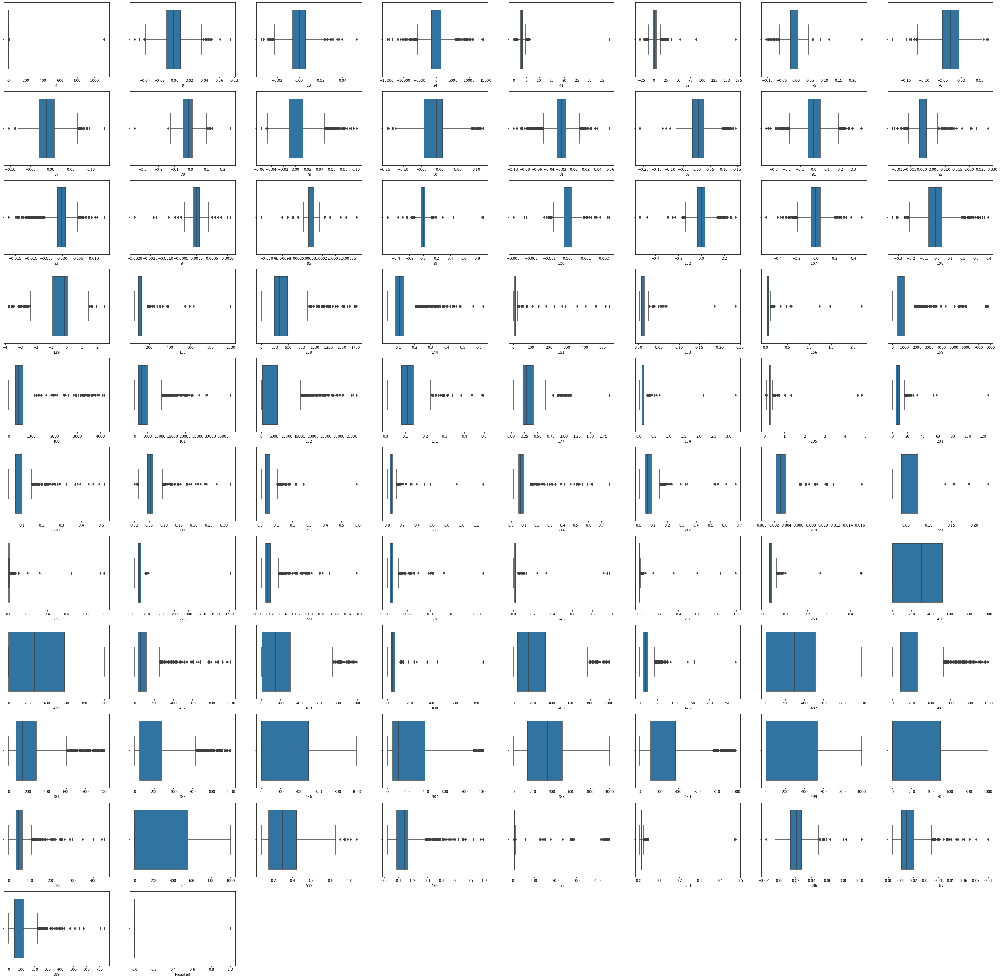

In [96]:
#Boxplot to check for outliers
plt.figure(figsize=(50, 50))
col = 1
for i in signal_df_before.columns:
    plt.subplot(11,8, col)
    sns.boxplot(signal_df_before[i])
    col += 1
plt.show()

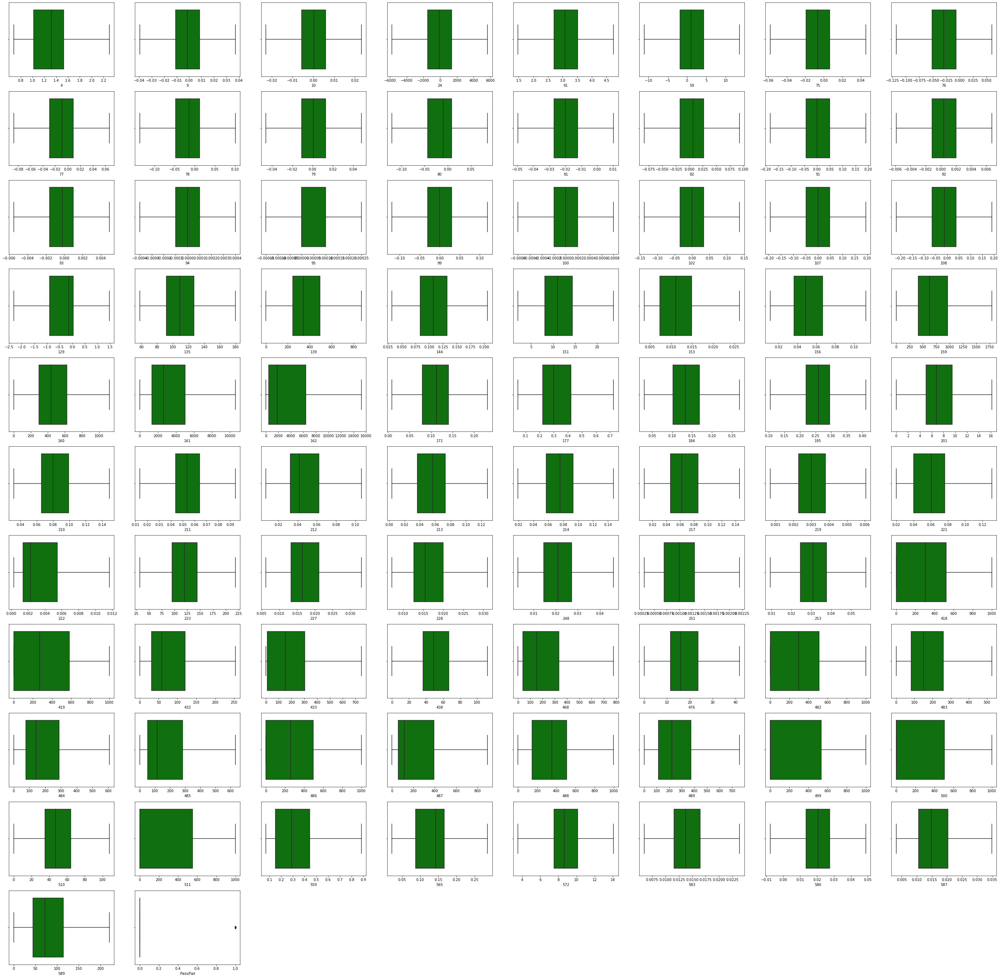

In [88]:
## After removing outlier
#Boxplot to check for outliers
plt.figure(figsize=(50, 50))
col = 1
for i in signal_df_im.columns:
    plt.subplot(11,8, col)
    sns.boxplot(signal_df_im[i],color='green')
    col += 1
plt.show()

#### Comments<br>
After capping method the outliers are removed.

**Comments:**

By capping method all the outliers are removed from the chosenn columns of Signaldata dataset

In [416]:
signal_df_im['Pass/Fail'].head()

0    0
1    0
2    1
3    0
4    0
Name: Pass/Fail, dtype: int64

In [417]:
signal_df_im.groupby(["Pass/Fail"]).count()

,4,9,10,24,41,59,75,76,77,78,...,500,510,511,559,565,572,583,586,587,589
Pass/Fail,,,,,,,,,,,,,,,,,,,,,
0,1463,1463,1463,1463,1463,1463,1463,1463,1463,1463,...,1463,1463,1463,1463,1463,1463,1463,1463,1463,1463
1,104,104,104,104,104,104,104,104,104,104,...,104,104,104,104,104,104,104,104,104,104


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">3. Data analysis & visualisation: [5 Marks]

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">A. Perform a detailed univariate Analysis with appropriate detailed comments after each analysis. [2 Marks]


For univariate analysis there are various ways. following are the common ways

* DistPlot<br>
* Pie Charts.<br>
* Box Plot

## Univariate Analysis

In [92]:
signal_df_im.shape

(1567, 82)

In [93]:
signal_df_im.isnull().sum().sum()

0

In [94]:
signal_df_im.dtypes.value_counts()

float64    81
int64       1
dtype: int64

###  comments<br>
1. After preprocessing there are 1567 records and 82 features <br>
2. All null columns are removed<br>
3. There are 81 float feature target variable (Pass/Fail ) is integer<br>

In [97]:
signal_df_im.columns

Index(['4', '9', '10', '24', '41', '59', '75', '76', '77', '78', '79', '80',
       '81', '82', '91', '92', '93', '94', '95', '99', '100', '102', '107',
       '108', '129', '135', '139', '144', '151', '153', '156', '159', '160',
       '161', '162', '171', '177', '184', '195', '201', '210', '211', '212',
       '213', '214', '217', '219', '221', '222', '223', '227', '228', '248',
       '251', '253', '418', '419', '432', '433', '438', '468', '476', '482',
       '483', '484', '485', '486', '487', '488', '489', '499', '500', '510',
       '511', '559', '565', '572', '583', '586', '587', '589', 'Pass/Fail'],
      dtype='object')

In [128]:
def plotDistPlot(data,col):
    sns.set_theme(); 
    plt.rcParams['figure.figsize'] = (7, 5)
    sns.distplot(data[col])
    plt.title('Distribution Plot for Feature '+col, fontsize = 20)
    plt.xlabel('Measurement of feature '+col)
    plt.show()


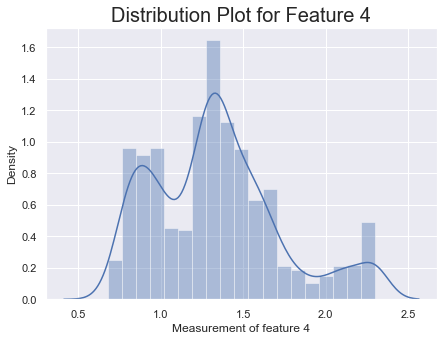

In [129]:
plotDistPlot(signal_df_im,'4')

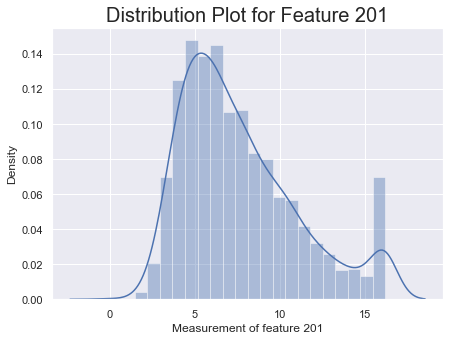

In [130]:
plotDistPlot(signal_df_im,'201')

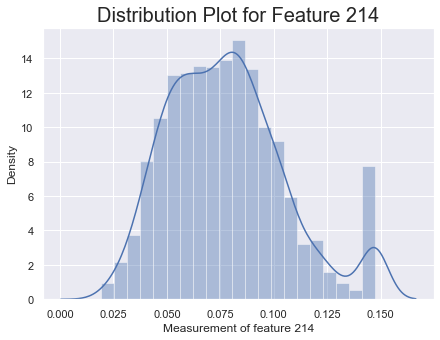

In [131]:
plotDistPlot(signal_df_im,'214')

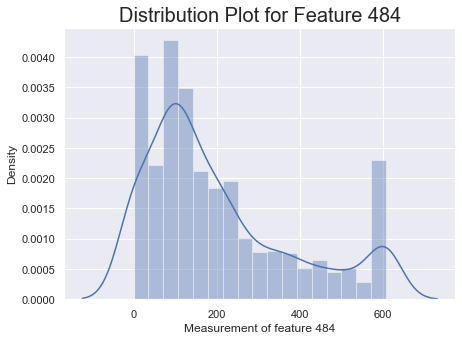

In [132]:
plotDistPlot(signal_df_im,'484')

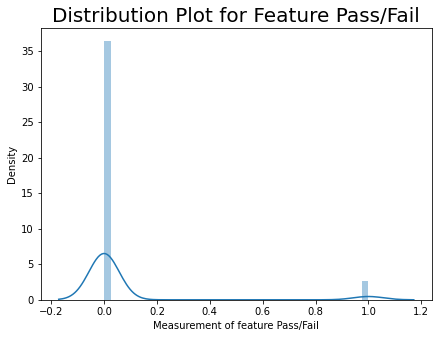

In [126]:
plotDistPlot(signal_df_im,'Pass/Fail')

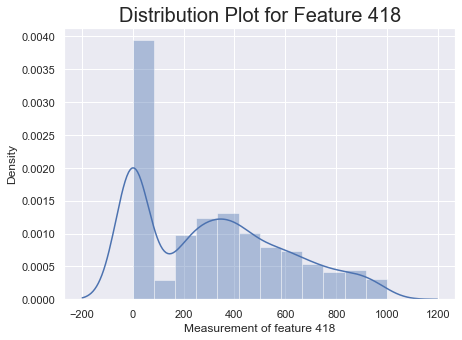

In [133]:
plotDistPlot(signal_df_im,'418')

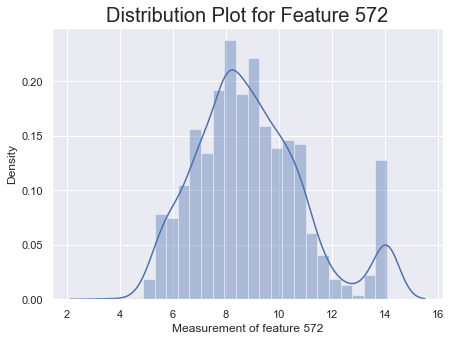

In [134]:
plotDistPlot(signal_df_im,'572')

**Comments**<br>
Mostly standard distribution is observed. few measurements show bimodal distribution and right skewed.


In [135]:
signal_df_im['Pass/Fail'].value_counts()

0    1463
1     104
Name: Pass/Fail, dtype: int64

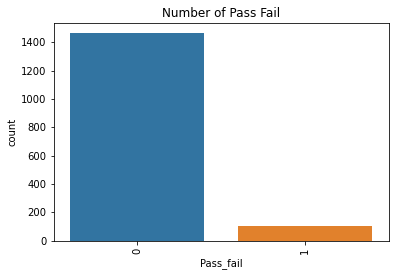

In [504]:
import seaborn as sns
sns.countplot(x='Pass/Fail', data=signal_df_im)
plt.title('Number of Pass Fail')
plt.ylabel('count')
plt.xlabel('Pass_fail')
plt.xticks(rotation = 90)
plt.show();

### Piechart for Pass / Fail distribution across that

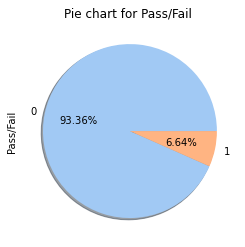

In [505]:
plt.title("Pie chart for Pass/Fail ")
colors = sns.color_palette('pastel')[0:5]
signal_df_im['Pass/Fail'].value_counts().plot.pie(autopct='%1.2f%%',shadow=True, colors=colors)
plt.show()

**Comments**:<br>
The target value is highly imbalanced. Only around 7% data has the expected target of "Pass" value. 

### Box plot after outlier removal for understanding the data distribution

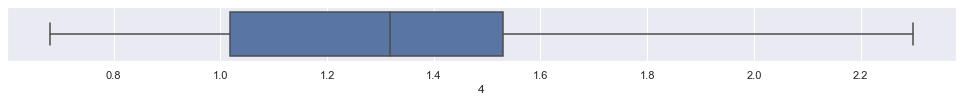

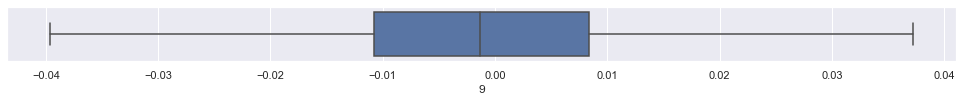

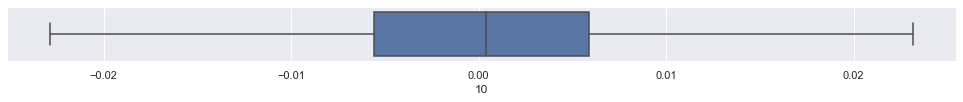

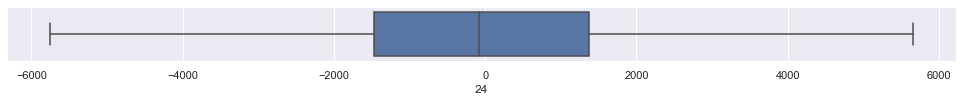

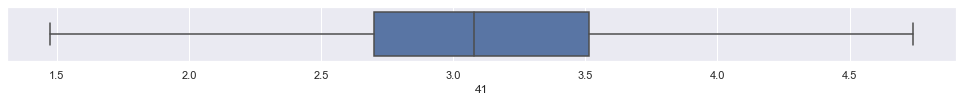

...

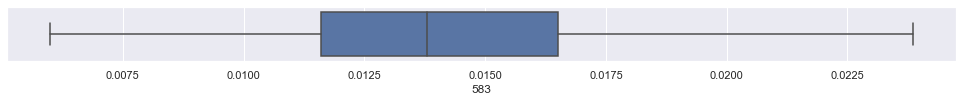

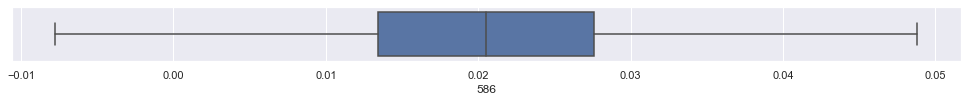

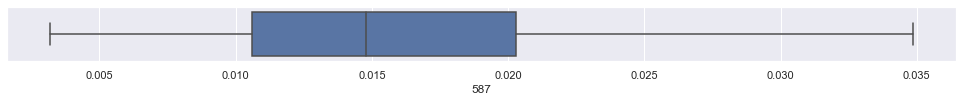

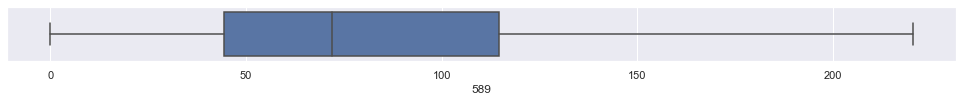

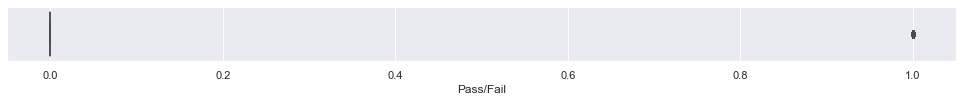

In [139]:
import matplotlib.pyplot as plt
signal_df_im1=signal_df_im.select_dtypes(exclude=['object'])

for column in signal_df_im1:
        plt.figure(figsize=(17,1))
        sns.boxplot(data=signal_df_im1, x=column)


### seggregating the data for better visualization

In [142]:
df_1 = signal_df_im.iloc[:,0:20]
df_1['Pass/Fail']=signal_df_im['Pass/Fail']

df_2 = signal_df_im.iloc[:,20:40]
df_2['Pass/Fail']=signal_df_im['Pass/Fail']

df_3 = signal_df_im.iloc[:,40:60]
df_3['Pass/Fail']=signal_df_im['Pass/Fail']

df_4 = signal_df_im.iloc[:,60:82]
#df_1['Pass/Fail']=signal_df_im['Pass/Fail']
df_4.head()


,468,476,482,483,484,485,486,487,488,489,...,510,511,559,565,572,583,586,587,589,Pass/Fail
0,311.6377,31.989300,613.3069,291.4842,494.6996,178.1759,843.1138,0.0000,53.1098,0.0000,...,64.670700,0.0000,0.4385,0.145610,8.95,0.01180,0.021458,0.016475,99.670066,0
1,463.2883,30.864300,0.0000,246.7762,0.0000,359.0444,130.6350,820.7900,194.4371,0.0000,...,107.584525,0.0000,0.1745,0.145610,5.92,0.02230,0.009600,0.020100,208.204500,0
2,21.3645,13.392300,434.2674,151.7665,0.0000,190.3869,746.9150,74.0741,191.7582,250.1742,...,107.584525,244.2748,0.3718,0.285575,11.21,0.01570,0.048825,0.034850,82.860200,1
3,24.2831,35.432300,225.0169,100.4883,305.7500,88.5553,104.6660,71.7583,0.0000,336.7660,...,107.584525,0.0000,0.7288,0.163000,9.33,0.01030,0.020200,0.014900,73.843200,0
4,44.8980,41.827975,171.4486,276.8810,461.8619,240.1781,0.0000,587.3773,748.1781,0.0000,...,107.584525,0.0000,0.2156,0.145610,8.83,0.02385,0.020200,0.014900,73.843200,0


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">B. Perform bivariate and multivariate analysis with appropriate detailed comments after each analysis. [3 Marks]

### Bivariate Analysis

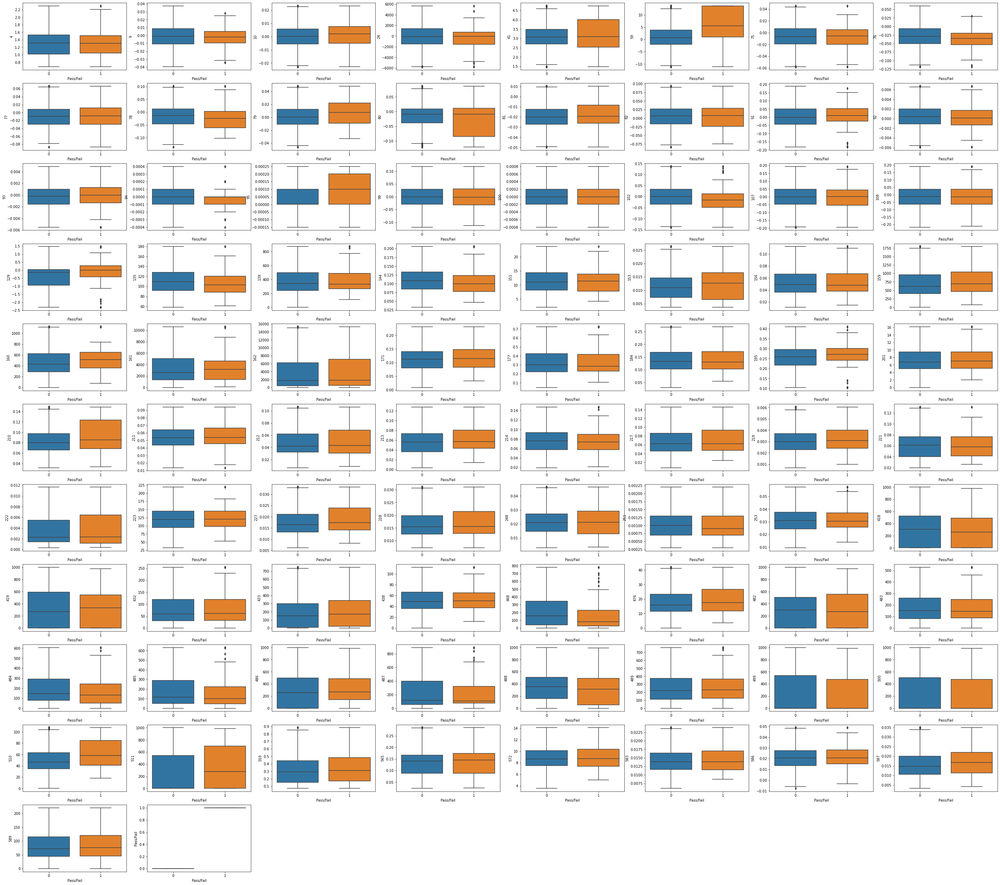

In [515]:
##df.boxplot(column = 'area_mean', by = 'diagnosis');
#plt.title('Box Plot for Bivariate analysis with Target variable')
#Boxplot to check for outliers
plt.figure(figsize=(50, 50))
col = 1
for i in signal_df_im.columns:
    plt.subplot(12,8, col)
    sns.boxplot(y=i, x='Pass/Fail',data=signal_df_im)
    col += 1

**Observation**:<br>
    * For analysing the data based on the Target value of Pass/ Fail bivariate analysis is done by box plot analysis <br>
    * Blue represents fail points and orange represent pass point<br>
    * General obsevation is pass data points has high IQR than the fail points for most of the points<br>
    * Median point is almost same for both kind of data points for most of the features<br>
    * Data points are not in different ranges<br>

Text(0, 0.5, 'Signal 4  %')

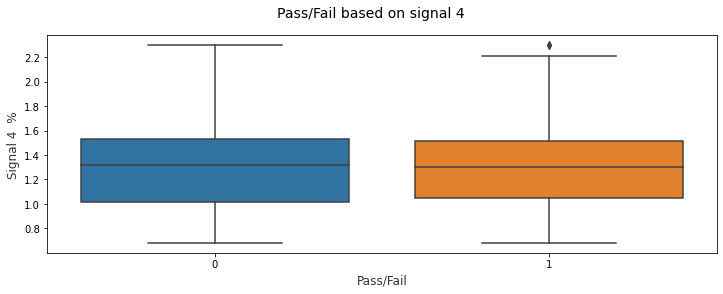

In [507]:

# Box Plots
f, (ax) = plt.subplots(1, 1, figsize=(12, 4))
f.suptitle('Pass/Fail based on signal 4', fontsize=14)

sns.boxplot(x="Pass/Fail", y="4", data=signal_df_im,  ax=ax)
ax.set_xlabel("Pass/Fail",size = 12,alpha=0.8)
ax.set_ylabel("Signal 4  %",size = 12,alpha=0.8)

**Observation** <br>
Median is same for Pass and Fail value for the feature 4 and failed feature is left skewed

Text(0, 0.5, 'Signal 9  %')

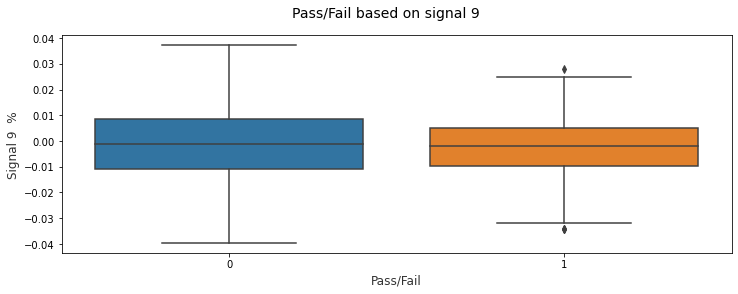

In [518]:

# Box Plots
f, (ax) = plt.subplots(1, 1, figsize=(12, 4))
f.suptitle('Pass/Fail based on signal 9', fontsize=14)

sns.boxplot(x="Pass/Fail", y="9", data=signal_df_im,  ax=ax)
ax.set_xlabel("Pass/Fail",size = 12,alpha=0.8)
ax.set_ylabel("Signal 9  %",size = 12,alpha=0.8)

**Observation** <br>
Median is same for Pass and Fail value for the feature 9 and both boxplots are normally distributed. IQR is high in Failed cases.

Text(0, 0.5, 'Signal 41  %')

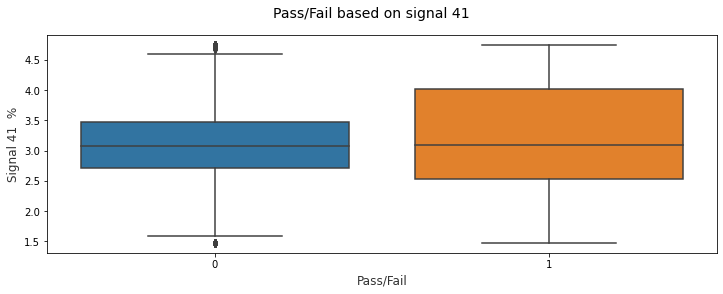

In [523]:

# Box Plots
f, (ax) = plt.subplots(1, 1, figsize=(12, 4))
f.suptitle('Pass/Fail based on signal 41', fontsize=14)

sns.boxplot(x="Pass/Fail", y="41", data=signal_df_im,  ax=ax)
ax.set_xlabel("Pass/Fail",size = 12,alpha=0.8)
ax.set_ylabel("Signal 41  %",size = 12,alpha=0.8)

**Observation** :<br>
For more analysis few of the features are visualuazied in detail for analysing<br> 
Median is same for Pass and Fail value for the feature 4 and passed feature is Right skewed

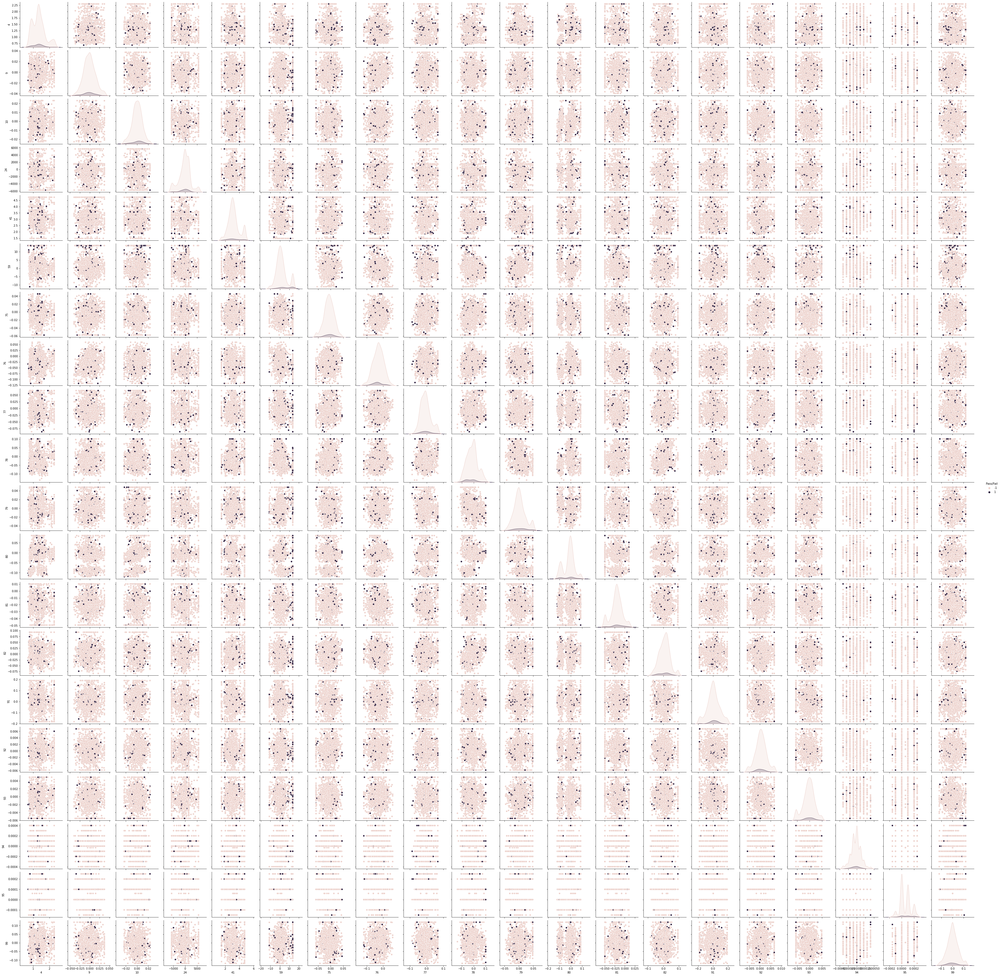

In [181]:
sns.pairplot(df_1 , hue="Pass/Fail" , diag_kind = 'kde')

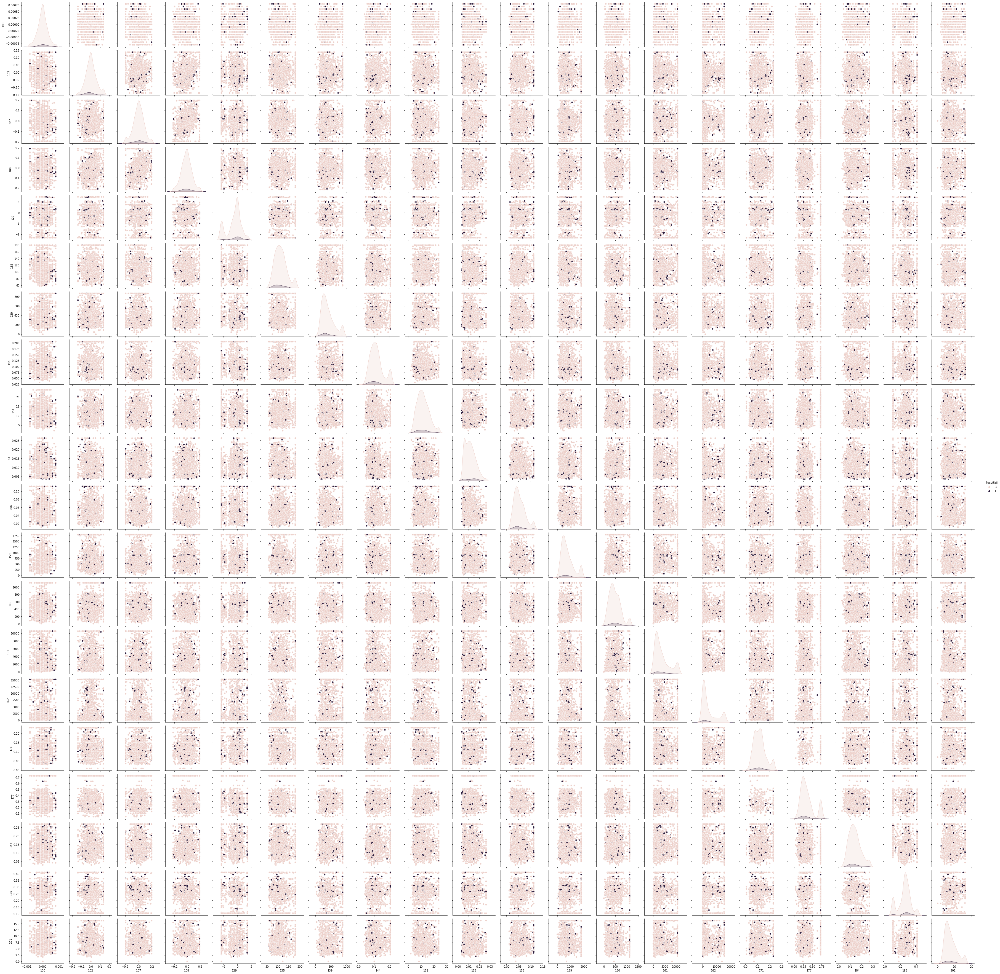

In [184]:
sns.pairplot(df_2 , hue="Pass/Fail" , diag_kind = 'kde')

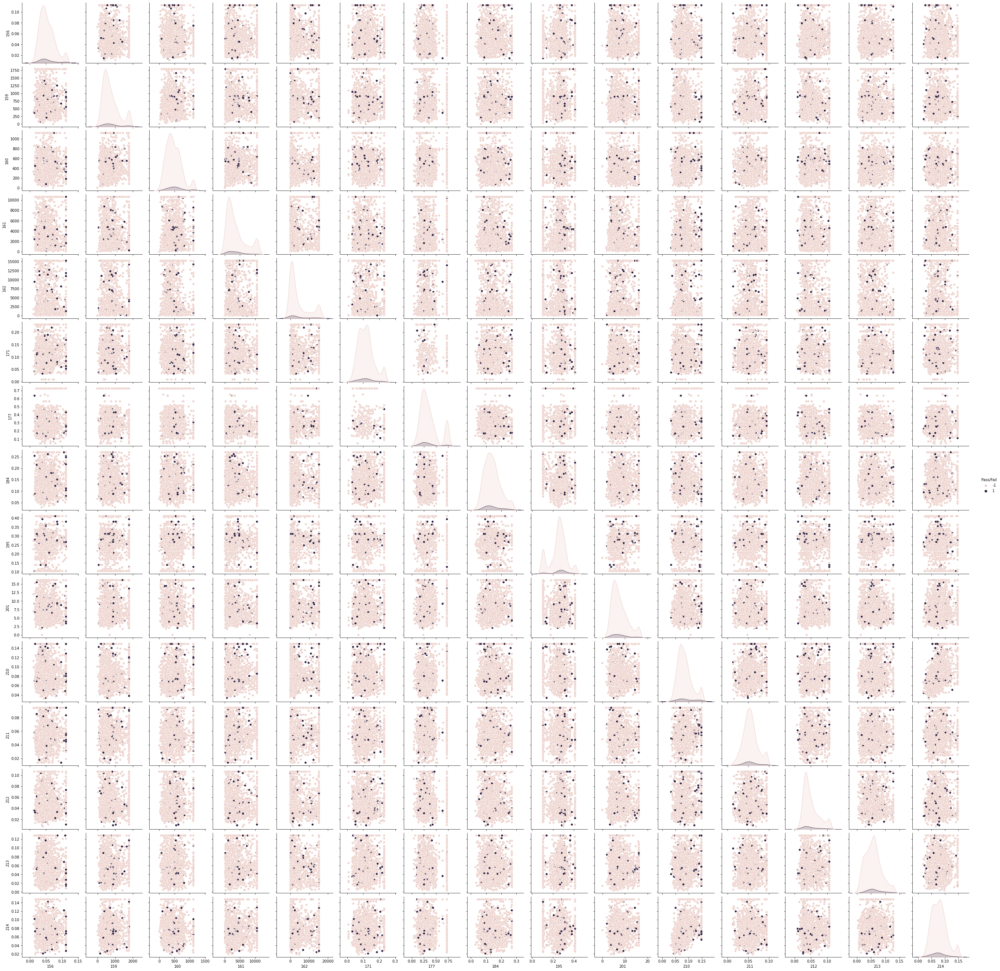

In [185]:
sns.pairplot(df_3 , hue="Pass/Fail" , diag_kind = 'kde')

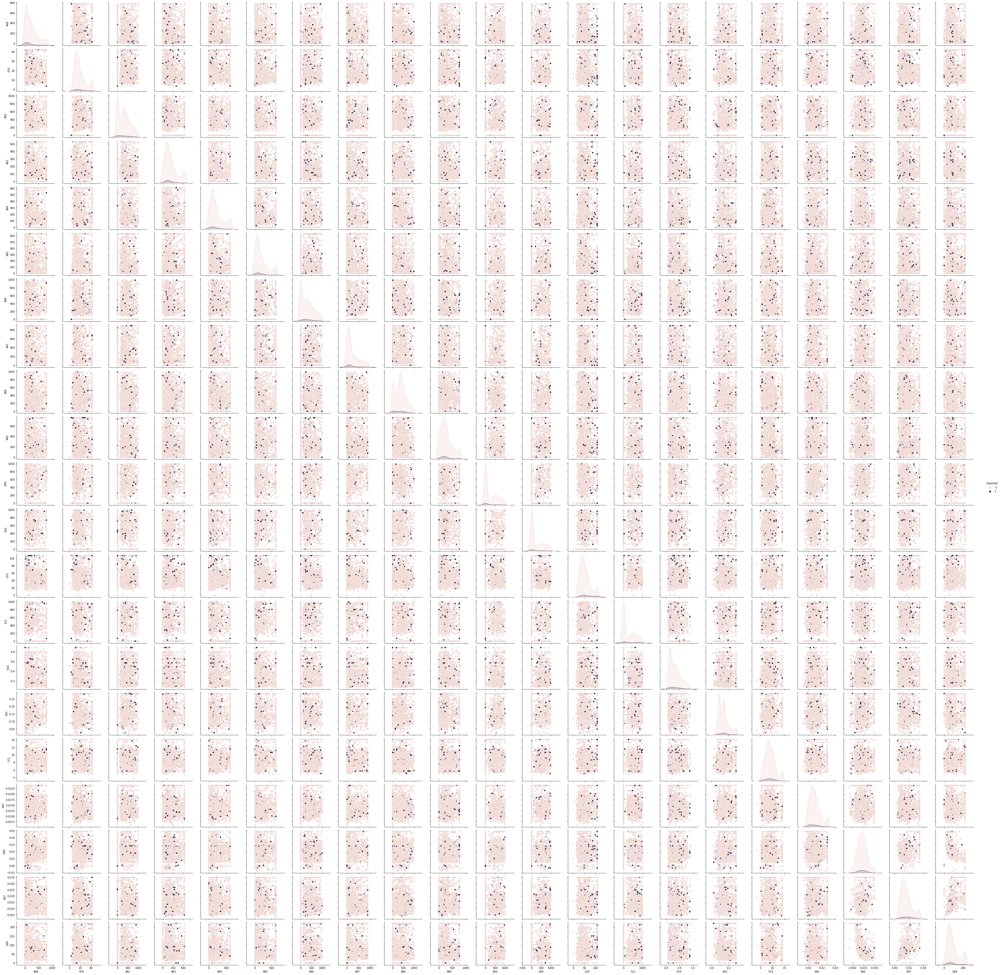

In [186]:
sns.pairplot(df_4 , hue="Pass/Fail" , diag_kind = 'kde')

In [525]:
signal_df_im_copy=signal_df_im.copy()

**Comments**:<br>
    For better visualisation the screened dataset is grouped into 4 subets and viewed with pass /fail varible as hue.
And its observed that most data is available in cloud and mosr or not correlated. Pattern wise, mostly normal distribution few binodal distribution also available.

### Multivariate analysis

<AxesSubplot:>

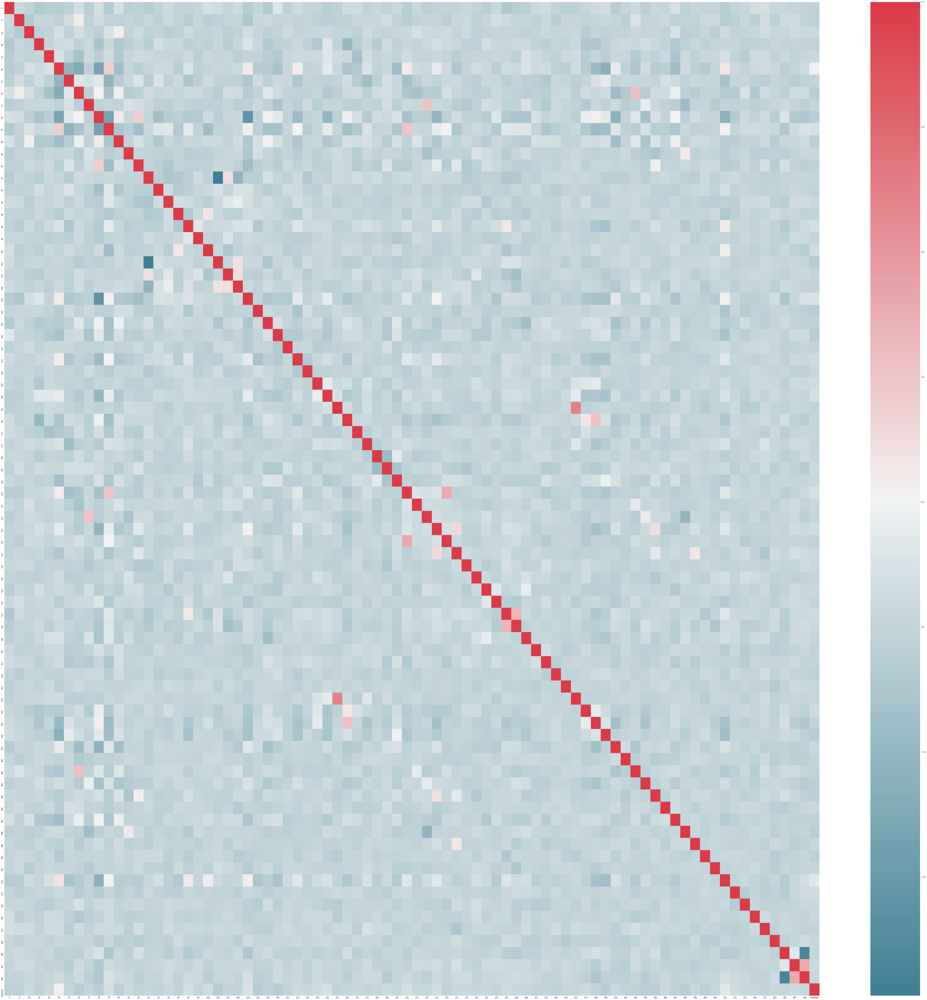

In [532]:
# Heatmap

fig, axis = plt.subplots(figsize = (100, 100))

corr = signal_df_im.corr()
# Generate a mask for the upper triangle
#mask = np.triu(np.ones_like(sdata.corr(), dtype=bool))
mask = np.zeros_like(corr, dtype = np.bool)

sns.heatmap(corr, mask = mask, cmap = sns.diverging_palette(220, 10, as_cmap = True), ax = axis)
# distribution plot to see the 
# Heatmap




**Comments**:<br>
The mulivariate visualization plot clearly shows that there very few data points are correlated after the feature engineering or after removal of noise.<br>

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">4. Data pre-processing: [10 Marks]<br>
<span style="font-family: Arial; font-weight:bold;font-size:1.0em;color:#00b3e5;">A. Segregate predictors vs target attributes. [2 Marks]


In [418]:
#Split data into Predictors(X) and Target Attributs(y)

X = signal_df_im.drop(labels= ['Pass/Fail'] , axis = 1)
y = signal_df_im["Pass/Fail"]
X.head()

,4,9,10,24,41,59,75,76,77,78,...,500,510,511,559,565,572,583,586,587,589
0,1.3602,0.0162,-0.0034,751.00,4.515,-1.726400,0.0126,-0.0206,0.0141,-0.0307,...,0.0000,64.670700,0.0000,0.4385,0.145610,8.95,0.01180,0.021458,0.016475,99.670066
1,0.8294,-0.0005,-0.0148,-1640.25,2.773,0.807300,-0.0039,-0.0198,0.0004,-0.0440,...,0.0000,107.584525,0.0000,0.1745,0.145610,5.92,0.02230,0.009600,0.020100,208.204500
2,1.5102,0.0041,0.0013,-1916.50,4.739,13.627425,-0.0078,-0.0326,-0.0052,0.0213,...,0.0000,107.584525,244.2748,0.3718,0.285575,11.21,0.01570,0.048825,0.034850,82.860200
3,1.3204,-0.0124,-0.0033,-1657.25,1.475,13.627425,-0.0555,-0.0461,-0.0400,0.0400,...,711.6418,107.584525,0.0000,0.7288,0.163000,9.33,0.01030,0.020200,0.014900,73.843200
4,1.5334,-0.0031,-0.0072,117.00,2.209,-11.145175,-0.0534,0.0183,-0.0167,-0.0449,...,0.0000,107.584525,0.0000,0.2156,0.145610,8.83,0.02385,0.020200,0.014900,73.843200


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">B. Check for target balancing and fix it if found imbalanced. [3 Marks]


In [419]:
signal_df_im["Pass/Fail"].value_counts()

0    1463
1     104
Name: Pass/Fail, dtype: int64

**Comments**:<br>Failed Data(93%) is more compared to Pass Data(nearly 7%).Target value is imbalanced.
* Here minority class is Pass which is more important<br>
* Synthetic Minority Oversampling Technique (SMOTE) will be used to balance the imbalanced data

In [145]:
# check version number
import imblearn
print(imblearn.__version__)

0.8.1


In [420]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from collections import Counter

#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)
sm = SMOTE(random_state=42)
X_resampled, y_resampled = sm.fit_resample(X, y)

In [147]:
X_resampled.head()

,4,9,10,24,41,59,75,76,77,78,...,500,510,511,559,565,572,583,586,587,589
0,1.3602,0.0162,-0.0034,751.00,4.515,-1.726400,0.0126,-0.0206,0.0141,-0.0307,...,0.0000,64.670700,0.0000,0.4385,0.145610,8.95,0.01180,0.021458,0.016475,99.670066
1,0.8294,-0.0005,-0.0148,-1640.25,2.773,0.807300,-0.0039,-0.0198,0.0004,-0.0440,...,0.0000,107.584525,0.0000,0.1745,0.145610,5.92,0.02230,0.009600,0.020100,208.204500
2,1.5102,0.0041,0.0013,-1916.50,4.739,13.627425,-0.0078,-0.0326,-0.0052,0.0213,...,0.0000,107.584525,244.2748,0.3718,0.285575,11.21,0.01570,0.048825,0.034850,82.860200
3,1.3204,-0.0124,-0.0033,-1657.25,1.475,13.627425,-0.0555,-0.0461,-0.0400,0.0400,...,711.6418,107.584525,0.0000,0.7288,0.163000,9.33,0.01030,0.020200,0.014900,73.843200
4,1.5334,-0.0031,-0.0072,117.00,2.209,-11.145175,-0.0534,0.0183,-0.0167,-0.0449,...,0.0000,107.584525,0.0000,0.2156,0.145610,8.83,0.02385,0.020200,0.014900,73.843200


In [148]:
X_resampled.shape

(2926, 81)

In [149]:
y_resampled.shape

(2926,)

In [85]:
print(Counter(X_resampled))

Counter({'4': 1, '9': 1, '10': 1, '24': 1, '41': 1, '59': 1, '75': 1, '76': 1, '77': 1, '78': 1, '79': 1, '80': 1, '81': 1, '82': 1, '91': 1, '92': 1, '93': 1, '94': 1, '95': 1, '99': 1, '100': 1, '102': 1, '107': 1, '108': 1, '129': 1, '135': 1, '139': 1, '144': 1, '151': 1, '153': 1, '156': 1, '159': 1, '160': 1, '161': 1, '162': 1, '171': 1, '177': 1, '184': 1, '195': 1, '201': 1, '210': 1, '211': 1, '212': 1, '213': 1, '214': 1, '217': 1, '219': 1, '221': 1, '222': 1, '223': 1, '227': 1, '228': 1, '248': 1, '251': 1, '253': 1, '418': 1, '419': 1, '432': 1, '433': 1, '438': 1, '468': 1, '476': 1, '482': 1, '483': 1, '484': 1, '485': 1, '486': 1, '487': 1, '488': 1, '489': 1, '499': 1, '500': 1, '510': 1, '511': 1, '559': 1, '565': 1, '572': 1, '583': 1, '586': 1, '587': 1, '589': 1})


**Comments:**<br>
By SMOTE the Train data is oversampled to balanced to contribute equally to minority and majority class

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">C. Perform train-test split and standardise the data or vice versa if required. [3 Marks]


In [421]:
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.20, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((2340, 81), (586, 81), (2340,), (586,))

In [155]:
y_train.head()

2826    1
2591    1
2227    1
2513    1
542     0
Name: Pass/Fail, dtype: int64

In [163]:
y_train.value_counts()

1    1183
0    1157
Name: Pass/Fail, dtype: int64

In [422]:
#Standardization
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
X_train_std = pd.DataFrame(sc.fit_transform(X_train),columns = X.columns)
X_test_std = pd.DataFrame(sc.fit_transform(X_test),columns = X.columns)
#X_train_std=sc.fit_transform(X_train)
#X_test_std=sc.fit_transform(X_test)

In [165]:
X_train_std.describe().T

,count,mean,std,min,25%,50%,75%,max
4,2340.0,2.303001e-16,1.000214,-1.898621,-0.703255,-0.013512,0.506486,2.891821
9,2340.0,1.684313e-17,1.000214,-2.879940,-0.628296,-0.027246,0.571731,2.962376
10,2340.0,-9.299304e-18,1.000214,-2.818840,-0.586204,0.075008,0.653060,2.775115
24,2340.0,-3.985416e-18,1.000214,-2.525555,-0.485721,0.129427,0.689615,2.781209
41,2340.0,7.872679e-16,1.000214,-2.309541,-0.686807,-0.143591,0.587540,1.955715
...,...,...,...,...,...,...,...,...
572,2340.0,-2.087599e-16,1.000214,-2.879714,-0.670123,-0.044994,0.604601,2.755809
583,2340.0,1.692853e-16,1.000214,-2.334922,-0.755772,-0.156783,0.551110,2.525047
586,2340.0,-1.071822e-16,1.000214,-2.913238,-0.666583,-0.080712,0.626371,2.718430
587,2340.0,-4.943814e-17,1.000214,-1.922274,-0.777295,-0.138348,0.625305,2.607550


In [166]:
X_train_std.head()

,4,9,10,24,41,59,75,76,77,78,...,500,510,511,559,565,572,583,586,587,589
0,0.299954,-0.263815,-0.356311,-0.008292,0.002331,-0.098536,-1.167219,-0.473436,-1.751208,0.936665,...,0.122606,2.097442,-0.332894,1.443285,0.541135,0.387716,0.372226,-0.632446,-0.379421,0.053431
1,-0.546901,-0.171413,0.406667,0.660320,-0.915364,0.944451,-0.318804,-1.586560,0.871134,-0.935331,...,-0.805631,-0.647319,1.004351,-0.660385,0.001084,1.166576,1.306862,0.531293,-0.599101,-0.794936
2,-0.109279,1.592675,0.407389,0.125057,-1.616833,1.520655,-2.500435,-2.703463,0.481138,-1.224015,...,0.600639,0.257251,0.130076,-0.115053,-0.022062,-0.715368,-1.273080,-0.235357,0.133928,0.054194
3,0.382007,-0.529724,0.822708,-0.776365,1.067081,0.817430,-1.032337,-0.156256,0.054216,-0.192742,...,-0.790144,0.686871,1.672304,-1.061244,-1.482132,0.443814,2.506534,0.825980,2.594587,1.757685
4,-1.540216,0.786722,-0.806232,2.781209,0.283066,-0.642125,0.629135,0.003322,1.625018,-0.141166,...,0.785674,-0.714172,-0.965552,-1.026453,0.001084,0.106792,1.041191,2.347794,-1.135101,-1.290652


**Comments**:<br>

* The imbalanced data is balanced through the SMOTE technique <br>
* Train data and Test Data is split <br>
* Then it is standardardized.<br>
* Standardizing the Train Data and Test data helps in avoiding Data leakage. 


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">D. Check if the train and test data have similar statistical characteristics when compared with original data. [2 Marks]


In [167]:
X_train_std.describe().T


,count,mean,std,min,25%,50%,75%,max
4,2340.0,2.303001e-16,1.000214,-1.898621,-0.703255,-0.013512,0.506486,2.891821
9,2340.0,1.684313e-17,1.000214,-2.879940,-0.628296,-0.027246,0.571731,2.962376
10,2340.0,-9.299304e-18,1.000214,-2.818840,-0.586204,0.075008,0.653060,2.775115
24,2340.0,-3.985416e-18,1.000214,-2.525555,-0.485721,0.129427,0.689615,2.781209
41,2340.0,7.872679e-16,1.000214,-2.309541,-0.686807,-0.143591,0.587540,1.955715
...,...,...,...,...,...,...,...,...
572,2340.0,-2.087599e-16,1.000214,-2.879714,-0.670123,-0.044994,0.604601,2.755809
583,2340.0,1.692853e-16,1.000214,-2.334922,-0.755772,-0.156783,0.551110,2.525047
586,2340.0,-1.071822e-16,1.000214,-2.913238,-0.666583,-0.080712,0.626371,2.718430
587,2340.0,-4.943814e-17,1.000214,-1.922274,-0.777295,-0.138348,0.625305,2.607550


In [168]:
X_test_std.describe().T

,count,mean,std,min,25%,50%,75%,max
4,586.0,-1.068542e-16,1.000854,-1.751839,-0.830601,-0.017416,0.609039,3.006197
9,586.0,4.007034e-17,1.000854,-2.799648,-0.632643,0.015883,0.576613,2.898891
10,586.0,3.315512e-19,1.000854,-2.735664,-0.588138,0.040634,0.628566,2.666348
24,586.0,2.235603e-17,1.000854,-2.619830,-0.479325,0.060156,0.705317,2.805058
41,586.0,3.323564e-16,1.000854,-2.205083,-0.674274,-0.149833,0.601037,1.853036
...,...,...,...,...,...,...,...,...
572,586.0,1.123106e-15,1.000854,-2.133105,-0.629494,-0.032990,0.560802,2.755077
583,586.0,-7.313073e-17,1.000854,-2.075665,-0.785188,-0.125611,0.629239,2.727779
586,586.0,2.531157e-16,1.000854,-2.678872,-0.650915,-0.014445,0.592199,2.669881
587,586.0,4.338585e-16,1.000854,-1.748520,-0.757982,-0.144621,0.648691,2.655193


In [219]:
signal_df_im.describe().T

,count,mean,std,min,25%,50%,75%,max
4,1567.0,1.335295,0.386295,0.681500,1.01770,1.3171,1.5296,2.297450
9,1567.0,-0.000941,0.014702,-0.039600,-0.01080,-0.0013,0.0084,0.037200
10,1567.0,0.000115,0.008888,-0.022850,-0.00560,0.0004,0.0059,0.023150
24,1567.0,-294.497759,2438.188894,-5750.312500,-1474.37500,-80.5000,1376.2500,5652.187500
41,1567.0,3.182415,0.781944,1.475000,2.69900,3.0800,3.5150,4.739000
...,...,...,...,...,...,...,...,...
583,1567.0,0.014398,0.003857,0.006000,0.01160,0.0138,0.0165,0.023850
586,1567.0,0.021117,0.010946,-0.007775,0.01345,0.0205,0.0276,0.048825
587,1567.0,0.016134,0.007547,0.003200,0.01060,0.0148,0.0203,0.034850
589,1567.0,89.098896,60.462630,0.000000,44.36860,72.0230,114.7497,220.321350


In [223]:
sctemp=StandardScaler()
signal_df_im_std = pd.DataFrame(sc.fit_transform(signal_df_im),columns = signal_df_im.columns)

In [225]:
signal_df_im_std.describe().T

,count,mean,std,min,25%,50%,75%,max
4,1567.0,-3.035932e-16,1.000319,-1.693017,-0.822420,-0.047117,0.503156,2.491520
9,1567.0,5.467147e-17,1.000319,-2.630367,-0.670814,-0.024434,0.635555,2.595108
10,1567.0,4.255386e-17,1.000319,-2.584708,-0.643217,0.032085,0.651111,2.592603
24,1567.0,8.402394e-17,1.000319,-2.238365,-0.484070,0.087797,0.685460,2.439755
41,1567.0,-1.555871e-16,1.000319,-2.184249,-0.618420,-0.131017,0.425467,1.991296
...,...,...,...,...,...,...,...,...
583,1567.0,2.005061e-17,1.000319,-2.178002,-0.725589,-0.154998,0.545273,2.451565
586,1567.0,2.919029e-16,1.000319,-2.640309,-0.700636,-0.056363,0.592479,2.532152
587,1567.0,-1.209779e-16,1.000319,-1.714342,-0.733477,-0.176770,0.552252,2.480845
589,1567.0,-2.499596e-16,1.000319,-1.474090,-0.740037,-0.282511,0.424378,2.171000


**Comments**<br>

* Comparing the 5 point summary of train data, Test data and original data after standardization, they are similar


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">5. Model training, testing and tuning: [20 Marks]

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">A.Use any Supervised Learning technique to train a model. [2 Marks]


###   For Base model using Logistic Regression Model

In [593]:
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import mean_squared_error, confusion_matrix, classification_report, roc_curve, precision_recall_curve, roc_auc_score, accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics
 # calculate precision and recall
p = precision_score(y_train, predictions_train)
r = recall_score(y_train, predictions_train)
model_scores.append(p)
model_scores.append(r)
print('precision',p)
print('recall',r)
 # calculate F1 score
f1_score = 2*(p*r)/(p+r)
model_scores.append(f1_score)
print('f1_score',f1_score)

In [594]:
colnames = ['accuracy','accuracy_cv_score','accuracy_cv_stddev',
                'precision_score','recall_score','f1_score',
                'roc_auc_score (cross_val_score)']
model_scores = []
model_stats = {}
model_columns=['accuracy','accuracy_mean_score','accuracy_stdfev','precision','recall','f1_score']

In [595]:

lr_model = LogisticRegression()
lr_model.fit(X_train_std, y_train)
y_pred = lr_model.predict(X_test_std)

# evaluate accuracy
print('accuracy score for Logistic Regression',accuracy_score(y_test, y_pred))
predictions=lr_model.predict(X_test_std)
lr_model.score(X_test_std, y_test)
model_scores.append(lr_model.score(X_test_std, y_test))
model_scores.append('NA')
model_scores.append('NA')

predictions_train=lr_model.predict(X_train_std)
print('accuracy score when Logistic Regression -Training set',accuracy_score(y_train, predictions_train))


accuracy score for Logistic Regression 0.764505119453925
accuracy score when Logistic Regression -Training set 0.8196581196581196


In [596]:
 # calculate precision and recall
p = precision_score(y_train, predictions_train)
r = recall_score(y_train, predictions_train)
model_scores.append(p)
model_scores.append(r)
print('precision',p)
print('recall',r)
 # calculate F1 score
f1_score = 2*(p*r)/(p+r)
model_scores.append(f1_score)
print('f1_score',f1_score)

precision 0.7998423955870765
recall 0.8579881656804734
f1_score 0.8278955954323002


In [558]:
 model_stats['LogisticRegression Basic Model'] = model_scores

In [559]:
df_model_stats = pd.DataFrame.from_dict(model_stats, orient='index', columns=model_columns)

In [560]:
df_model_stats

,accuracy,accuracy_mean_score,accuracy_stdfev,precision,recall,f1_score
LogisticRegression Basic Model,0.799842,0.857988,0.827896,0.799842,0.857988,0.827896


In [597]:
# evaluate accuracy
print('accuracy score when Logistic Regression',accuracy_score(y_test, predictions))
#print('accuracy score Train when Logistic Regression',accuracy_score(y_train, predictions))
print(classification_report(y_test, predictions))


accuracy score when Logistic Regression 0.764505119453925
              precision    recall  f1-score   support

           0       0.80      0.74      0.77       306
           1       0.74      0.79      0.76       280

    accuracy                           0.76       586
   macro avg       0.77      0.77      0.76       586
weighted avg       0.77      0.76      0.76       586



<AxesSubplot:>

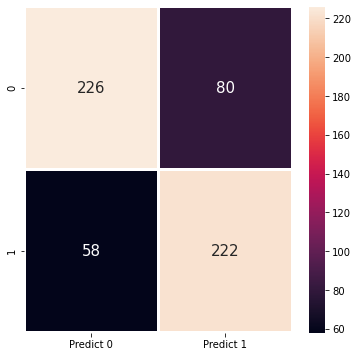

In [598]:
# calculate accuracy measures and confusion matrix
cm=metrics.confusion_matrix(y_test, predictions, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["Predict 0","Predict 1"]])
plt.figure(figsize = (6,6))
sns.heatmap(df_cm, annot=True,linewidths=2, linecolor='white', fmt='g', annot_kws={"size":15}) 

**Comments**<br>
With the Logistic Regression as base model got 80% accuracy

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">B.Use cross validation techniques. [3 Marks]<br>
Hint: Use all CV techniques that you have learnt in the course

In [599]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
num_folds = 50
seed = 7
kfold = KFold(n_splits=num_folds, random_state=seed,shuffle=True)

In [600]:
model=LogisticRegression()
results = cross_val_score(model, X_train_std, y_train, cv=kfold)
print(results)
print("Accuracy: %.3f%% (%.3f%%)" % (results.mean()*100.0, results.std()*100.0))


[0.80851064 0.78723404 0.87234043 0.85106383 0.80851064 0.80851064
 0.74468085 0.80851064 0.80851064 0.78723404 0.68085106 0.78723404
 0.85106383 0.78723404 0.74468085 0.78723404 0.76595745 0.80851064
 0.87234043 0.87234043 0.80851064 0.82978723 0.85106383 0.72340426
 0.72340426 0.87234043 0.76595745 0.76595745 0.78723404 0.82978723
 0.82978723 0.87234043 0.82978723 0.91489362 0.85106383 0.74468085
 0.82978723 0.82978723 0.78723404 0.78723404 0.76086957 0.76086957
 0.76086957 0.7826087  0.76086957 0.67391304 0.84782609 0.82608696
 0.76086957 0.73913043]
Accuracy: 79.901% (5.020%)


In [601]:
resultmean_max="{:.2f}".format(results.mean()+2*results.std())

In [279]:
resultmean_max

'0.90'

In [602]:
resultmean_min="{:.2f}".format(results.mean()-2*results.std())

In [291]:
resultmean_min

'0.70'

In [299]:
range=resultmean_min+' to '+resultmean_max

In [320]:
range

'0.70 to 0.90'

In [603]:
model_scores = []


In [604]:
model_scores.append('NA')

In [605]:
model_scores.append(results.mean())

In [606]:
model_scores.append(results.std())

In [607]:
model_scores.append('NA')
model_scores.append('NA')
model_scores.append('NA')

In [608]:
len(model_scores)

6

In [609]:
model_stats['LogisticRegression with Kfold Cross validation'] = model_scores
df_model_stats = pd.DataFrame.from_dict(model_stats, orient='index', columns=model_columns)
df_model_stats


,accuracy,accuracy_mean_score,accuracy_stdfev,precision,recall,f1_score
LogisticRegression with Kfold Cross validation,NA,0.79901,0.050199,NA,NA,NA


#### Comments
Cross validation on training set gives the Accuracy of 79.901 accuracy with standard deviation of 8.208 percentage.<br>
Hence the model will perform with the range of 79.901+/-2( 5.20)<br>
That is it will give accurate result between **69.5**  and **91.36** percent accuracy for 95% of confidence

#### LOOCV technique

In [637]:
# loocv to evaluate the Logistic Regression Model
from sklearn.model_selection import LeaveOneOut

from sklearn.metrics import accuracy_score

# create loocv procedure
cv = LeaveOneOut()
# enumerate splits

model =LogisticRegression(random_state=1)
scores = cross_val_score(model, X_train_std, y_train,cv=cv)


In [638]:
scores

array([1., 1., 0., ..., 1., 0., 1.])

In [640]:
print(np.mean(scores))

0.8008547008547009


**Comments**<br>

In [ ]:
Mean score with LOOCV is 80% for Logistic Regression.

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;"> C.Apply hyper-parameter tuning techniques to get the best accuracy. [3 Marks]

In [177]:
logistic_regression_model = LogisticRegression()
logistic_regression_model.get_params()

{'C': 1.0,
 'class_weight': None,
 'dual': False,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'l1_ratio': None,
 'max_iter': 100,
 'multi_class': 'auto',
 'n_jobs': None,
 'penalty': 'l2',
 'random_state': None,
 'solver': 'lbfgs',
 'tol': 0.0001,
 'verbose': 0,
 'warm_start': False}

In [586]:

from sklearn.model_selection import GridSearchCV

# defining parameter range
param_grid = {'penalty': ['l1', 'l2'],'C':[0.001,.009,0.01,.09,1,5,10,25]}
 
grid = GridSearchCV(logistic_regression_model, param_grid, refit = True, verbose = 3)

# fitting the model for grid search
grid.fit(X_train_std, y_train)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ............................C=0.001, penalty=l1; total time=   0.0s
[CV 2/5] END ............................C=0.001, penalty=l1; total time=   0.0s
[CV 3/5] END ............................C=0.001, penalty=l1; total time=   0.0s
[CV 4/5] END ............................C=0.001, penalty=l1; total time=   0.0s
[CV 5/5] END ............................C=0.001, penalty=l1; total time=   0.0s
[CV 1/5] END ............................C=0.001, penalty=l2; total time=   0.0s
[CV 2/5] END ............................C=0.001, penalty=l2; total time=   0.0s
[CV 3/5] END ............................C=0.001, penalty=l2; total time=   0.0s
[CV 4/5] END ............................C=0.001, penalty=l2; total time=   0.0s
[CV 5/5] END ............................C=0.001, penalty=l2; total time=   0.0s
[CV 1/5] END ............................C=0.009, penalty=l1; total time=   0.0s
[CV 2/5] END ............................C=0.009

GridSearchCV(estimator=LogisticRegression(),
             param_grid={'C': [0.001, 0.009, 0.01, 0.09, 1, 5, 10, 25],
                         'penalty': ['l1', 'l2']},
             verbose=3)

In [587]:
# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

{'C': 5, 'penalty': 'l2'}
LogisticRegression(C=5)


In [612]:
grid.score(X_test_std, y_test)

0.764505119453925

In [613]:
model_scores = []
model_scores.append(grid.score(X_test_std, y_test))
model_scores.append('NA')
model_scores.append('NA')


In [590]:
grid_predictions = grid.predict(X_test_std)
 
# print classification report
print(classification_report(y_test, grid_predictions))

              precision    recall  f1-score   support

           0       0.80      0.74      0.77       306
           1       0.73      0.80      0.76       280

    accuracy                           0.76       586
   macro avg       0.77      0.77      0.76       586
weighted avg       0.77      0.76      0.76       586



<AxesSubplot:>

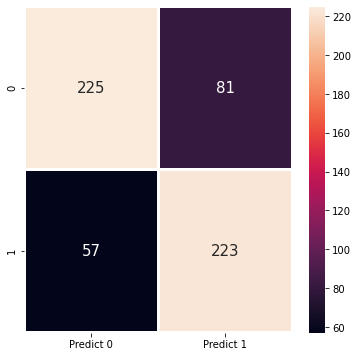

In [591]:
# calculate accuracy measures and confusion matrix
cm=metrics.confusion_matrix(y_test, grid_predictions, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["Predict 0","Predict 1"]])
plt.figure(figsize = (6,6))
sns.heatmap(df_cm, annot=True,linewidths=2, linecolor='white', fmt='g', annot_kws={"size":15}) 

In [615]:
model_stats['LogisticRegression HyperparameterTuning with Grid SearchCV'] = model_scores
df_model_stats = pd.DataFrame.from_dict(model_stats, orient='index', columns=model_columns)
df_model_stats

,accuracy,accuracy_mean_score,accuracy_stdfev,precision,recall,f1_score
LogisticRegression with Kfold Cross validation,NA,0.79901,0.050199,NA,NA,NA
LogisticRegression HyperparameterTuning with Grid SearchCV,0.764505,NA,NA,None,None,None


#### Randomized Search CV

In [623]:
from sklearn.model_selection import RepeatedStratifiedKFold
from scipy.stats import loguniform
from sklearn.model_selection import RandomizedSearchCV

# random search logistic regression model on the sonar dataset

# define model
model = LogisticRegression()
# define evaluation
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# define search space
space = dict()
space['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
space['C'] = loguniform(1e-5, 100)
# define search
search = RandomizedSearchCV(model, space, n_iter=500, scoring='accuracy', n_jobs=-1, cv=cv, random_state=1)
# execute search
result = search.fit(X_train_std, y_train)
# summarize result
print('Best Score: %s' % result.best_score_)
print('Best Hyperparameters: %s' % result.best_params_)

Best Score: 0.8008547008547009
Best Hyperparameters: {'C': 0.4152561875287414, 'penalty': 'l1', 'solver': 'liblinear'}


In [629]:
model_scores=[]
model_stats['LogisticRegression Randomsearch'] = model_scores    
model_scores.append(result.best_score_)
model_scores.append('NA')
model_scores.append('NA')
df_model_stats = pd.DataFrame.from_dict(model_stats, orient='index', columns=model_columns)

df_model_stats

,accuracy,accuracy_mean_score,accuracy_stdfev,precision,recall,f1_score
LogisticRegression with Kfold Cross validation,NA,0.79901,0.050199,NA,NA,NA
LogisticRegression HyperparameterTuning with Grid SearchCV,0.764505,NA,NA,0.800855,NA,NA
LogisticRegression Randomsearch,0.800855,NA,NA,None,None,None


**Comments**:

With Random seach CV the accuracy increased to 80%. 

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">D. Use any other technique/method which can enhance the model performance. [4 Marks]
Hint: Dimensionality reduction, attribute removal, standardisation/normalisation, target balancing etc.

In [116]:
## standardising the data for applying PCA
from scipy.stats import zscore
XScaled  = X.apply(zscore)  # convert all attributes to Z scale 
XScaled.describe().T

,count,mean,std,min,25%,50%,75%,max
4,1567.0,-3.035932e-16,1.000319,-1.693017,-0.822420,-0.047117,0.503156,2.491520
9,1567.0,5.467147e-17,1.000319,-2.630367,-0.670814,-0.024434,0.635555,2.595108
10,1567.0,4.255386e-17,1.000319,-2.584708,-0.643217,0.032085,0.651111,2.592603
24,1567.0,8.402394e-17,1.000319,-2.238365,-0.484070,0.087797,0.685460,2.439755
41,1567.0,-1.555871e-16,1.000319,-2.184249,-0.618420,-0.131017,0.425467,1.991296
...,...,...,...,...,...,...,...,...
572,1567.0,1.557288e-16,1.000319,-2.575277,-0.681714,-0.129724,0.580662,2.474226
583,1567.0,2.005061e-17,1.000319,-2.178002,-0.725589,-0.154998,0.545273,2.451565
586,1567.0,2.919029e-16,1.000319,-2.640309,-0.700636,-0.056363,0.592479,2.532152
587,1567.0,-1.209779e-16,1.000319,-1.714342,-0.733477,-0.176770,0.552252,2.480845


In [117]:
XScaled.shape

(1567, 81)

In [196]:
X_train_std.shape

(2340, 81)

In [197]:
y_train.head()

2826    1
2591    1
2227    1
2513    1
542     0
Name: Pass/Fail, dtype: int64

In [182]:
covMatrix = np.cov(X_train_std,rowvar=False)
print(covMatrix)

[[ 1.00042753  0.05763903 -0.01572221 ...  0.00986334  0.02378165
  -0.00509575]
 [ 0.05763903  1.00042753 -0.04423837 ...  0.00736918 -0.02545753
  -0.05160001]
 [-0.01572221 -0.04423837  1.00042753 ...  0.00645895  0.06289845
   0.01658081]
 ...
 [ 0.00986334  0.00736918  0.00645895 ...  1.00042753  0.1701497
  -0.53570534]
 [ 0.02378165 -0.02545753  0.06289845 ...  0.1701497   1.00042753
   0.50623058]
 [-0.00509575 -0.05160001  0.01658081 ... -0.53570534  0.50623058
   1.00042753]]


In [120]:
from sklearn.decomposition import PCA

In [183]:
pca = PCA(n_components=70)
pca.fit(X_train_std)

PCA(n_components=70)

In [122]:
##Eigen Values

In [184]:
print(pca.explained_variance_)

[4.77837727 2.90674887 2.39204868 2.37187048 2.23442865 2.12548836
 2.03569967 1.95084972 1.87120119 1.72754186 1.71230856 1.58170519
 1.57454365 1.51340064 1.45023933 1.4111692  1.40198516 1.36467305
 1.35059894 1.31480732 1.29748387 1.26491246 1.24912842 1.15817809
 1.14026825 1.12908061 1.10496462 1.0649612  1.03196045 1.01076181
 0.98738755 0.9649638  0.94906648 0.94548435 0.91490352 0.89298433
 0.87056919 0.84951716 0.8413372  0.81485407 0.80929077 0.78880329
 0.77390464 0.76408745 0.74505566 0.74244777 0.71596418 0.7117887
 0.69889316 0.68165573 0.67946408 0.66203123 0.64373154 0.62783191
 0.61432842 0.59243058 0.58264389 0.56972365 0.56174841 0.55093105
 0.54577835 0.53607795 0.49285258 0.48497688 0.47552275 0.45814005
 0.43813537 0.43048159 0.41834998 0.40579872]


In [185]:
print(pca.components_)

[[-0.06919801 -0.07530375  0.01179921 ... -0.07698734  0.09201112
   0.14624285]
 [ 0.0861386  -0.03854709  0.14079685 ...  0.02881449  0.11777238
   0.07612375]
 [-0.0353434  -0.04029512  0.0357127  ...  0.16101201  0.03615462
  -0.12000792]
 ...
 [-0.10400518  0.01180247 -0.11497742 ...  0.03865682 -0.02521734
   0.02344777]
 [-0.03537271  0.08354097  0.20852017 ... -0.00079964 -0.01062105
  -0.01854226]
 [-0.11390717 -0.04226709 -0.08886692 ...  0.05489143  0.05728076
   0.00903367]]


In [186]:
print(pca.explained_variance_ratio_)

[0.0589671  0.03587045 0.02951884 0.02926984 0.02757375 0.02622938
 0.02512135 0.02407427 0.02309138 0.02131856 0.02113058 0.01951888
 0.0194305  0.01867597 0.01789654 0.0174144  0.01730106 0.01684062
 0.01666694 0.01622525 0.01601147 0.01560953 0.01541475 0.01429238
 0.01407137 0.01393331 0.01363571 0.01314205 0.01273481 0.01247321
 0.01218476 0.01190804 0.01171186 0.01166766 0.01129028 0.01101979
 0.01074317 0.01048338 0.01038244 0.01005563 0.00998697 0.00973415
 0.0095503  0.00942915 0.00919429 0.0091621  0.00883529 0.00878376
 0.00862462 0.00841191 0.00838486 0.00816973 0.00794391 0.0077477
 0.00758106 0.00731083 0.00719006 0.00703062 0.0069322  0.00679871
 0.00673512 0.00661542 0.006082   0.00598481 0.00586814 0.00565363
 0.00540677 0.00531232 0.00516261 0.00500772]


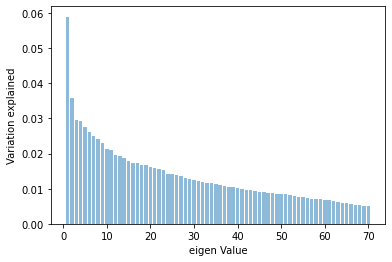

In [187]:
plt.bar(list(range(1,71)),pca.explained_variance_ratio_,alpha=0.5, align='center')
plt.ylabel('Variation explained')
plt.xlabel('eigen Value')
plt.show()

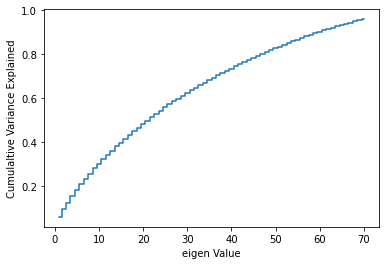

In [188]:
plt.step(list(range(1,71)),np.cumsum(pca.explained_variance_ratio_), where='mid')
plt.ylabel('Cumulaltive Variance Explained')
plt.xlabel('eigen Value')
plt.show()

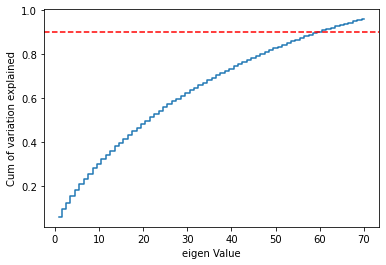

In [189]:
plt.step(list(range(1,71)),np.cumsum(pca.explained_variance_ratio_), where='mid')
plt.ylabel('Cum of variation explained')
plt.xlabel('eigen Value')
plt.axhline(y = 0.9, color = 'r', linestyle = 'dashed')    
plt.show()
# line colour is red




In [190]:
pca = PCA(n_components=65)
pca.fit(X_train_std)

PCA(n_components=65)

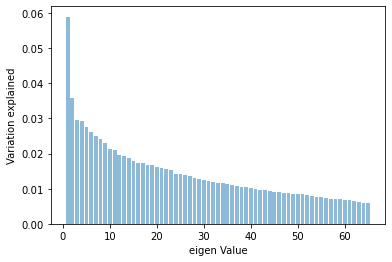

In [191]:
plt.bar(list(range(1,66)),pca.explained_variance_ratio_,alpha=0.5, align='center')
plt.ylabel('Variation explained')
plt.xlabel('eigen Value')
plt.show()

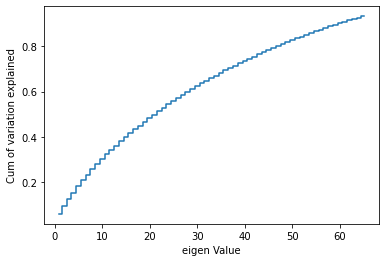

In [192]:
plt.step(list(range(1,66)),np.cumsum(pca.explained_variance_ratio_), where='mid')
plt.ylabel('Cum of variation explained')
plt.xlabel('eigen Value')
plt.show()

In [237]:
from sklearn.decomposition import PCA
#pca = PCA(n_components=2)
principalComponents = pca.fit_transform(X_train_std)
principalDf = pd.DataFrame(data = principalComponents)

In [238]:
pca_train=pca.fit_transform(X_train_std)
pca_test=pca.fit_transform(X_test_std)

In [348]:
model=LogisticRegression()
lr_model.fit(pca_train, y_train)
y_pred = lr_model.predict(pca_test)
# evaluate accuracy
print('accuracy score for Logistic Regression',accuracy_score(y_test, y_pred))
predictions=lr_model.predict(pca_test)
lr_model.score(pca_test, y_test)
# evaluate accuracy
print('accuracy score when Logistic Regression',accuracy_score(y_test, predictions))
print(classification_report(y_test, predictions))
model_scores = []
model_scores.append(lr_model.score(pca_test, y_test))
model_scores.append('NA')
model_scores.append('NA')

accuracy score for Logistic Regression 0.5597269624573379
accuracy score when Logistic Regression 0.5597269624573379
              precision    recall  f1-score   support

           0       0.58      0.56      0.57       306
           1       0.54      0.56      0.55       280

    accuracy                           0.56       586
   macro avg       0.56      0.56      0.56       586
weighted avg       0.56      0.56      0.56       586



<AxesSubplot:>

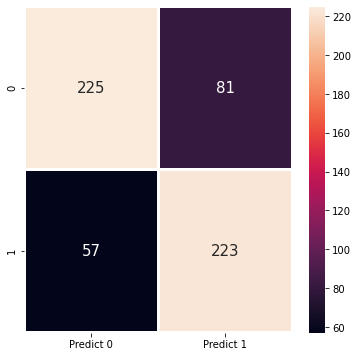

In [243]:
# calculate accuracy measures and confusion matrix
cm=metrics.confusion_matrix(y_test, grid_predictions, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["Predict 0","Predict 1"]])
plt.figure(figsize = (6,6))
sns.heatmap(df_cm, annot=True,linewidths=2, linecolor='white', fmt='g', annot_kws={"size":15}) 

In [354]:
model_stats['LogisticRegression after PCA'] = model_scores
df_model_stats = pd.DataFrame.from_dict(model_stats, orient='index', columns=model_columns)


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">E.Display and explain the classification report in detail. [3 Marks]

In [357]:
df_model_stats

,accuracy,min_range,max_range
LogisticRegression Basic Model,0.764505,NA,NA
LogisticRegression with Kfold Cross validation,NA,0.70,0.90
LogisticRegression HyperparameterTuning with Grid SearchCV,0.764505,NA,NA
LogisticRegression after PCA,0.559727,NA,NA


### Comments:

* The Accuracy score not improved with PCA. As the features are already reduced, it did not help in improving the accuracy
* Through Cross validation it is identified that the model will perform well with 95% confidence with the range of 0.70 to 0.90
* Grid Seach CV did not improve the model performance much

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">F.Apply the above steps for all possible models that you have learnt so far. [5 Marks]

In [440]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn.tree import DecisionTreeClassifier

#### The method will get the Models,Predictors and targets and input and output with the classification metrics

In [441]:
import pandas as pd
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_score, recall_score, roc_auc_score
            
            
def get_model_scores(models, X_train, y_train, X_test, y_test):
    """
    paramters: models (dict), X_train (dataframe, array), y_train (dataframe, array)
        
    Function outputs these metrics:
        > 'accuracy',
        > 'accuracy_cv_score',
        > 'accuracy_cv_stddev',
        > 'precision_score',
        > 'recall_score',
        > 'f1_score',
        > 'roc_auc_score (cross_val_score)'
    """
    
    model_stats = {}
    for mname, minst in models.items():
        model_scores = []

        # create pipeline with scaler and model instantiation steps
        #model_pipe = make_pipeline(StandardScaler(), minst)
        model_pipe = make_pipeline(minst)

        # fit training data and run model score
        model_pipe.fit(X_train, y_train)
        model_scores.append(model_pipe.score(X_test, y_test))
        model_scores.append(model_pipe.score(X_train, y_train))
        
        # implement cross validation model accuracy score
        scores = cross_val_score(model_pipe, X_train, y_train, cv=10, scoring='accuracy')
        model_scores.append(scores.mean())
        model_scores.append(scores.std())

        # implement cross validation predictions on training data
        y_train_cv_pred = cross_val_predict(model_pipe, X_train, y_train, cv=10)

        # calculate precision and recall
        p = precision_score(y_train, y_train_cv_pred)
        r = recall_score(y_train, y_train_cv_pred)
        model_scores.append(p)
        model_scores.append(r)

        # calculate F1 score
        f1_score = 2*(p*r)/(p+r)
        model_scores.append(f1_score)

        # calculate ROC AUC score using cross_val_score
        roc_auc_cvs = cross_val_score(model_pipe, X_train, y_train, cv=10, scoring='roc_auc').mean()
        model_scores.append(roc_auc_cvs)

        # create dictionary key/pair value
        model_stats[mname] = model_scores
    
    colnames = ['accuracy','accuracy_train_score','accuracy_cv_score','accuracy_cv_stddev',
                'precision_score','recall_score','f1_score',
                'roc_auc_score (cross_val_score)']

    # put model stats into a dataframe
    df_model_stats = pd.DataFrame.from_dict(model_stats, orient='index', columns=colnames)
    df_model_stats_ranked = df_model_stats.sort_values(by='accuracy', ascending=False)

    # output is a dataframe
    return df_model_stats_ranked

#### All the classification models with Standardized Test data is passed to get the Classifcation report

In [431]:
# random_state=0 for reproducibility; create dictionary for function parameter
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import cross_val_predict
models = {
          'LogisticRegression': LogisticRegression(random_state=0),
          'SupportVectorMachines': svm.SVC(random_state=0),
          'RandomForest': RandomForestClassifier(random_state=0),
          'KNN': KNeighborsClassifier(n_neighbors=5),
          'GaussianNaiveBayes': GaussianNB(),
          'DecisionTree': DecisionTreeClassifier(random_state=0)}

# use helper function (output_model_stats) to generate all performance and model diagnostic metrics
df_all_models = get_model_scores(models, X_train_std, y_train, X_test_std, y_test)

# output dataframe
df_all_models

,accuracy,accuracy_train_score,accuracy_cv_score,accuracy_cv_stddev,precision_score,recall_score,f1_score,roc_auc_score (cross_val_score)
SupportVectorMachines,0.994881,1.000000,0.997436,0.003419,0.995788,0.999155,0.997468,0.999949
RandomForest,0.959044,1.000000,0.979487,0.010256,0.986290,0.972950,0.979574,0.998133
GaussianNaiveBayes,0.802048,0.808547,0.803846,0.012304,0.809932,0.799662,0.804764,0.887901
LogisticRegression,0.764505,0.819658,0.802137,0.019681,0.782132,0.843618,0.811712,0.858289
DecisionTree,0.650171,1.000000,0.888462,0.019626,0.871176,0.914624,0.892371,0.888205
KNN,0.546075,0.628205,0.564957,0.016857,0.537483,1.000000,0.699173,0.793100


In [436]:
####

<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;"> 6.Post Training and Conclusion: [5 Marks]


<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">A. Display and compare all the models designed with their train and test accuracies. [1 Marks]

In [442]:
df_all_models

,accuracy,accuracy_train_score,accuracy_cv_score,accuracy_cv_stddev,precision_score,recall_score,f1_score,roc_auc_score (cross_val_score)
SupportVectorMachines,0.994881,1.000000,0.997436,0.003419,0.995788,0.999155,0.997468,0.999949
RandomForest,0.959044,1.000000,0.979487,0.010256,0.986290,0.972950,0.979574,0.998133
GaussianNaiveBayes,0.802048,0.808547,0.803846,0.012304,0.809932,0.799662,0.804764,0.887901
LogisticRegression,0.764505,0.819658,0.802137,0.019681,0.782132,0.843618,0.811712,0.858289
DecisionTree,0.650171,1.000000,0.888462,0.019626,0.871176,0.914624,0.892371,0.888205
KNN,0.546075,0.628205,0.564957,0.016857,0.537483,1.000000,0.699173,0.793100


#### Obeservation <br>
* Among all the models trained and tested Support Vector Machine performance is the best <br>
* **Support Vector Machine** performs best both  in test and Train data set <br>
* In train data set, able to get 100% accuracy and it equally performs well in Test data, which is good for production <br>
* recall score and f1 score also at its best, which is very much required for correct classification <br>
* In the given semiconductor data set problem finding the Pass values are important as they are minority class and expected target value to find. The model able to perform best in that case as well



<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;"> B. Select the final best trained model along with your detailed comments for selecting this model. [1 Marks]

In [444]:
#### The Final Selected Model is Support Vector Machine and will get the details here

In [455]:
import pandas as pd
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_score, recall_score, roc_auc_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
            
            
def get_single_model_score_with_reports(models, X_train, y_train, X_test, y_test):
    """
    paramters: models (dict), X_train (dataframe, array), y_train (dataframe, array)
        
    Function outputs these metrics:
        > 'accuracy',
        > 'accuracy_cv_score',
        > 'accuracy_cv_stddev',
        > 'precision_score',
        > 'recall_score',
        > 'f1_score',
        > 'roc_auc_score (cross_val_score)'
    """
    
    model_stats = {}
    for mname, minst in models.items():
        model_scores = []

        # create pipeline with scaler and model instantiation steps
        #model_pipe = make_pipeline(StandardScaler(), minst)
        model_pipe = make_pipeline(minst)

        # fit training data and run model score
        model_pipe.fit(X_train, y_train)
        model_scores.append(model_pipe.score(X_test, y_test))
        model_scores.append(model_pipe.score(X_train, y_train))
        
        # Classification Report
        predictions=model_pipe.predict(X_test)
        #print(classification_report(y_test, predictions))
        #classification_report=classification_report(y_test, predictions)
        
        # Confusion Matrix
        # calculate accuracy measures and confusion matrix
        cm=metrics.confusion_matrix(y_test, predictions, labels=[0, 1])

        df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["Predict 0","Predict 1"]])
        plt.figure(figsize = (6,6))
        sns.heatmap(df_cm, annot=True,linewidths=2, linecolor='white', fmt='g', annot_kws={"size":15}) 
        
        # implement cross validation model accuracy score
        scores = cross_val_score(model_pipe, X_train, y_train, cv=10, scoring='accuracy')
        model_scores.append(scores.mean())
        model_scores.append(scores.std())

        # implement cross validation predictions on training data
        y_train_cv_pred = cross_val_predict(model_pipe, X_train, y_train, cv=10)

        # calculate precision and recall
        p = precision_score(y_train, y_train_cv_pred)
        r = recall_score(y_train, y_train_cv_pred)
        model_scores.append(p)
        model_scores.append(r)

        # calculate F1 score
        f1_score = 2*(p*r)/(p+r)
        model_scores.append(f1_score)

        # calculate ROC AUC score using cross_val_score
        roc_auc_cvs = cross_val_score(model_pipe, X_train, y_train, cv=10, scoring='roc_auc').mean()
        model_scores.append(roc_auc_cvs)

        # create dictionary key/pair value
        model_stats[mname] = model_scores
    
    colnames = ['accuracy','accuracy_train_score','accuracy_cv_score','accuracy_cv_stddev',
                'precision_score','recall_score','f1_score',
                'roc_auc_score (cross_val_score)']

    # put model stats into a dataframe
    df_model_stats = pd.DataFrame.from_dict(model_stats, orient='index', columns=colnames)
    df_model_stats_ranked = df_model_stats.sort_values(by='accuracy', ascending=False)

    # output is a dataframe
    return model_pipe,df_model_stats_ranked

Pipeline(steps=[('svc', SVC(random_state=0))])


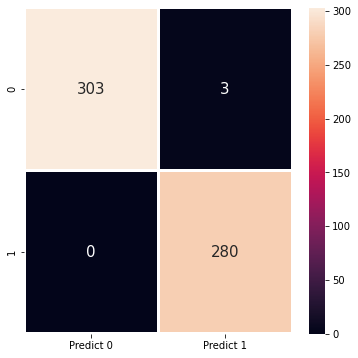

In [457]:
# random_state=0 for reproducibility; create dictionary for function parameter
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import cross_val_predict
models = {         
          'SupportVectorMachines': svm.SVC(random_state=0)
          }

# use helper function (output_model_stats) to generate all performance and model diagnostic metrics
final_model, df_final_model = get_single_model_score_with_reports(models, X_train_std, y_train, X_test_std, y_test)

# output dataframe
df_final_model
print(final_model)

In [459]:
df_final_model

,accuracy,accuracy_train_score,accuracy_cv_score,accuracy_cv_stddev,precision_score,recall_score,f1_score,roc_auc_score (cross_val_score)
SupportVectorMachines,0.994881,1.0,0.997436,0.003419,0.995788,0.999155,0.997468,0.999949


In [654]:

from sklearn.model_selection import GridSearchCV
 
# defining parameter range
param_grid = {'C': [0.1, 1, 10, 100, 1000],
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'kernel': ['rbf']}
 
grid = GridSearchCV(svm.SVC(), param_grid, refit = True, verbose = 3)
 
# fitting the model for grid search
grid.fit(X_train_std, y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits
[CV 1/5] END .....................C=0.1, gamma=1, kernel=rbf; total time=   0.3s
[CV 2/5] END .....................C=0.1, gamma=1, kernel=rbf; total time=   0.2s
[CV 3/5] END .....................C=0.1, gamma=1, kernel=rbf; total time=   0.3s
[CV 4/5] END .....................C=0.1, gamma=1, kernel=rbf; total time=   0.2s
[CV 5/5] END .....................C=0.1, gamma=1, kernel=rbf; total time=   0.2s
[CV 1/5] END ...................C=0.1, gamma=0.1, kernel=rbf; total time=   0.2s
[CV 2/5] END ...................C=0.1, gamma=0.1, kernel=rbf; total time=   0.3s
[CV 3/5] END ...................C=0.1, gamma=0.1, kernel=rbf; total time=   0.2s
[CV 4/5] END ...................C=0.1, gamma=0.1, kernel=rbf; total time=   0.2s
[CV 5/5] END ...................C=0.1, gamma=0.1, kernel=rbf; total time=   0.2s
[CV 1/5] END ..................C=0.1, gamma=0.01, kernel=rbf; total time=   0.2s
[CV 2/5] END ..................C=0.1, gamma=0.0

[CV 2/5] END ....................C=1000, gamma=1, kernel=rbf; total time=   0.3s
[CV 3/5] END ....................C=1000, gamma=1, kernel=rbf; total time=   0.3s
[CV 4/5] END ....................C=1000, gamma=1, kernel=rbf; total time=   0.3s
[CV 5/5] END ....................C=1000, gamma=1, kernel=rbf; total time=   0.3s
[CV 1/5] END ..................C=1000, gamma=0.1, kernel=rbf; total time=   0.3s
[CV 2/5] END ..................C=1000, gamma=0.1, kernel=rbf; total time=   0.3s
[CV 3/5] END ..................C=1000, gamma=0.1, kernel=rbf; total time=   0.2s
[CV 4/5] END ..................C=1000, gamma=0.1, kernel=rbf; total time=   0.3s
[CV 5/5] END ..................C=1000, gamma=0.1, kernel=rbf; total time=   0.2s
[CV 1/5] END .................C=1000, gamma=0.01, kernel=rbf; total time=   0.1s
[CV 2/5] END .................C=1000, gamma=0.01, kernel=rbf; total time=   0.1s
[CV 3/5] END .................C=1000, gamma=0.01, kernel=rbf; total time=   0.1s
[CV 4/5] END ...............

GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             verbose=3)

In [655]:
# print best parameter after tuning
print(grid.best_params_)
 
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

{'C': 10, 'gamma': 0.01, 'kernel': 'rbf'}
SVC(C=10, gamma=0.01)


In [466]:

grid_predictions = grid.predict(X_test_std)
 
# print classification report
print(classification_report(y_test, grid_predictions))

              precision    recall  f1-score   support

           0       1.00      0.99      0.99       306
           1       0.99      1.00      0.99       280

    accuracy                           0.99       586
   macro avg       0.99      0.99      0.99       586
weighted avg       0.99      0.99      0.99       586



<AxesSubplot:>

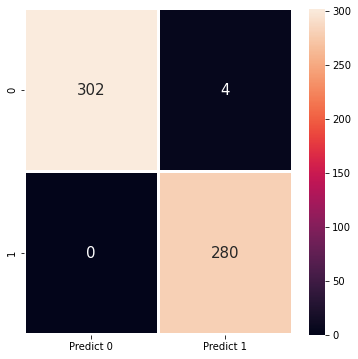

In [468]:
# calculate accuracy measures and confusion matrix
cm=metrics.confusion_matrix(y_test, grid_predictions, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["Predict 0","Predict 1"]])
plt.figure(figsize = (6,6))
sns.heatmap(df_cm, annot=True,linewidths=2, linecolor='white', fmt='g', annot_kws={"size":15}) 

Pipeline(steps=[('svc', SVC(C=10, gamma=0.01, random_state=0))])


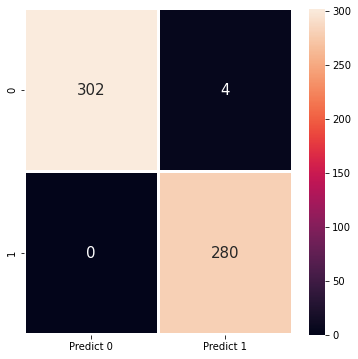

In [647]:
#SVC(C=10, gamma=0.01)
# random_state=0 for reproducibility; create dictionary for function parameter
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import cross_val_predict
models = {         
          'SupportVectorMachines': svm.SVC(C=10, gamma=0.01,kernel= 'rbf',random_state=0)
          }

# use helper function (output_model_stats) to generate all performance and model diagnostic metrics
final_model, df_final_model = get_single_model_score_with_reports(models, X_train_std, y_train, X_test_std, y_test)

# output dataframe
df_final_model
print(final_model)

In [656]:
model_svm=grid.best_estimator_

In [657]:
model_svm

SVC(C=10, gamma=0.01)

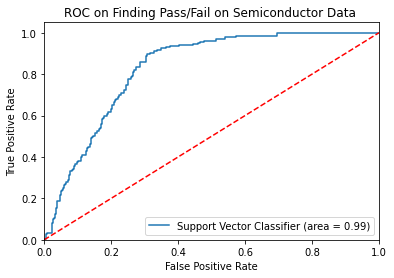

In [659]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
logit_roc_auc = roc_auc_score(y_test, model_svm.predict(X_test_std))
fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_std)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Support Vector Classifier (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC on Finding Pass/Fail on Semiconductor Data ')
plt.legend(loc="lower right")
plt.savefig('svm_ROC')
plt.show()

**Comments** : ROC curve shows relationship between False Positive Rate and True Positive Rate across different thresholds.The are under curve shows
the models is more predictive.

In [503]:
df_final_model

,accuracy,accuracy_train_score,accuracy_cv_score,accuracy_cv_stddev,precision_score,recall_score,f1_score,roc_auc_score (cross_val_score)
SupportVectorMachines,0.993174,1.0,0.994872,0.004984,0.989958,1.0,0.994954,0.999993



<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">C. Pickle the selected model for future use. [2 Marks]

In [479]:
model_final_svm=grid.best_estimator_
final_predictions = model_final_svm.predict(X_test_std)


# Model Accuracy: how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, final_predictions))

Accuracy: 0.9931740614334471


In [483]:
model_final_svm.intercept_

array([-2.0456489])

In [484]:
### Save Model To a File Using Python Pickle

In [486]:
import pickle
with open('model_pickle','wb') as file:
    pickle.dump(model_final_svm,file)

### Load Saved Model

In [489]:
with open('model_pickle','rb') as file:
    mp = pickle.load(file)

In [491]:
mp.intercept_

array([-2.0456489])

In [493]:
#Predict the response for test dataset
y_pred = mp.predict(X_test_std)

In [498]:
from sklearn import metrics

# Model Accuracy: how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9931740614334471



<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">D. Write your conclusion on the results. [1 Marks]


**Conclusion:**

Through the proper feature selection and Data preparation following are the advantages.<br>
* Not all the features are important for model building. So these has to be properly evaluated and removed.
* And finding the important features provide vital role before building any model
* This gives less computation time, reducing the noise.

In this project, as per the instructions given, the unwanted features are removed (like removing features having more null value, features with same data  are removed. And the high correlated features and multicollinear columns which has more than 10 percent threshold are removed.Multicollinear features result in less reliable statistical inference.<br> With all these steps around 82 features are retained.Which is reasonable for model building. 

Predictors and Target features are seperated and it is been observed that the data is highly imbalanced. Through SMOTE, the data is balanced.To avoid Data Leakage, Test and Train data are seperated and then standardized for model building.All these steps helped in reducing computational time with the provided multidimensional feature.

And Base Model is built and model is been tuned with Hyper parameter techniques and expected performance in production is calculated throgh kfold cross validation. And all these steps repeated for different models best model is selected.For this semiconductor data SVM performs best among all the model in terms of accuracy and Recall. It performs equally well in test as in Training.                                                                                  
                                                                                   

Hence, its been concluded that by the **"Featurization, Model selection and Tuning",** with the multidimensional data, the best model
is identified as **Support Vector Classifier** with (C=10, gamma=0.01,kernel=rbf)-**"Radial Basis Function"** and it can give upto **99.9%* accuracy in test data and 95% confidence of performing **98.5 to 100%** in production based on cross validation.